# Домашнее задание № 7 

In [10]:
from pathlib import Path
from concurrent.futures import ThreadPoolExecutor

import os
import cv2
import skimage
import numpy as np
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
import time
# from sklearn.linear_model import RANSACRegressor
from scipy.spatial import distance
from scipy.spatial.distance import pdist
# from sklearn.cluster import AgglomerativeClustering
import time
import random
from torch import nn
from torch.optim import Adam, SGD
import torch

# Поиск объектов в видеопотоке 

Задача - придумать и реализовать алгоритм поиска (обнаружения без классификации) движущихся объектов.

В качестве исходных данных приведена выборка с видеофайлами и аннотацией для каждого кадра файла. Аннотация задана в виде ограничивающих прямоугольников в формате ```(y1,x1,y2,x2)```, где
- ```(x1,y1)``` - верхний левый угол прямоугольника;
- ```(x2,y2)``` - нижний правый угол прямоугольника.

Ссылка на данные – https://disk.yandex.ru/d/RdjMDoQQO8Ngcw

В качестве обучающей можно брать любые видеофайлы. При этом должны быть отдельно выбраны тестовые данные, которые не будут использованы в создании решения. 

Видеофайл с результатами работы алгоритма должен быть прикреплен вместе с решением. Пример фрагмента видеофайла с результатом поиска объектов приведен ниже.

Исходный код может быть в формате ```.py``` или ```.ipynb```.

![annotation](annot_example.gif "annotation")

## Требования к результату
- поиск должен находить геометрические место объекта на видеоизображении. Геометрическое место задано ограничивающим прямоугольником (bounding box);
- продолжительность решения для любого одного видеофайла не должна превышать 10 минут;
- должна быть приведена оценка точности решения;
- привести демонстрацию результатов требется на одном из тестовых видеофайлов.

In [11]:
# вспомогательная функция
def plot_one_image(src_image, is_gray=False):
    """
    Отрисовать с помощью plt исходное изображение.
    
    :param src_image: np.ndarray: исходное изображение
    :param is_gray: bool: флаг для отображения ЧБ изображений
    :return: None
    """
    fig, m_axs = plt.subplots(1, 1, figsize=(6*2, 4*2), constrained_layout=True)
    ax1 = m_axs

    cmap = 'gray' if is_gray else None
    ax1.set_title('Исходное изображение')
    ax1.imshow(src_image, cmap=cmap)
    ax1.set_xticks([]), ax1.set_yticks([])
    plt.show()

In [12]:
def draw_points(image, points, rect=0, gray=True):
    color1 = (0, 255, 0)
    color2 = (0, 0, 255)
    output = image.copy()
    if gray:
        output = cv2.cvtColor(image.copy(), cv2.COLOR_GRAY2RGB)
        
    for point in points:
        output = cv2.circle(output, point, 3, color1, -1)
    
    if type(rect) != int:
        output = cv2.rectangle(output, rect[0], rect[1], color2)
    
    plot_one_image(output)

In [13]:
def get_video_details(cap, do_print=True):
    cnt = cap.get(cv2.CAP_PROP_FRAME_COUNT)
    w = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
    h = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
    fps = cap.get(cv2.CAP_PROP_FPS)

    if do_print:
        print(cnt, w, h, fps)
    return cnt, w, h, fps

In [14]:
def get_video(num=-1, file_name="", path='./Videos/Videos/'):
    """
    Функция достающая видео
    num - номер видео (если num == -1, то достаются все видео)
    
    """
    if file_name != "":
        return cv2.VideoCapture(path+file_name)
    
    all_names = os.listdir(path)
    names = []
    for name in all_names:
        if name.endswith(".mov") or name.endswith(".mp4"):
            names.append(name)
            
    if num >= 0:
        print(name)
        name_vid = names[num]
        return cv2.VideoCapture(path+name_vid)
        
        
    videos = []
    for name_vid in names:
        videos.append(cv2.VideoCapture(path+name_vid))
    return videos
    

In [15]:
def create_video(save_dir, size, img_format='jpg', vido_format='avi'):
    out_name = Path(save_dir).parts[-1]

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(str(Path(save_dir) / Path(f'{out_name}.{vido_format}')),
                          fourcc, 20, tuple(size.astype(int)))

    for fname in tqdm(sorted(map(str, Path(save_dir).glob(f'*.{img_format}')))):
        imag = skimage.io.imread(fname)
        imag = cv2.cvtColor(imag, cv2.COLOR_RGB2BGR)
        out.write(imag)
    out.release()

In [16]:
def show_video(num=-1,path='./tmp/', sleep=0):
    cap = get_video(num if num >=0 else 0, path=path)
    get_video_details(cap)
    cv2.startWindowThread()
    while (cap.isOpened()):
        is_ok, frame = cap.read()
        if not is_ok:
            break
            
        if sleep > 0:
            time.sleep(sleep)

        cv2.imshow("sparse optical flow", frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

In [17]:
class AnnotationRect:
    def __init__(self, i, point1=None, point2=None):
        self.i = i
        self.x1 = point1[0] if point1 != None else -1 
        self.y1 = point1[1] if point1 != None else -1 
        self.x2 = point2[0] if point2 != None else -1 
        self.y2 = point2[1] if point2 != None else -1 
        
    def get_w(self):
        return self.x2 - self.x1

    def get_h(self):
        return self.y2 - self.y1
    
    def get_point1(self):
        return np.array([self.x1, self.y1])
    
    def get_point2(self):
        return np.array([self.x2, self.y2])
    
    def get_center(self):
        return (self.get_point1() + self.get_point2())//2
    
    def set_point1(self, point):
        self.x1 = point[0] 
        self.y1 = point[1]  
        
    def set_point2(self, point):
        self.x2 = point[0] 
        self.y2 = point[1]
        
    def is_there(self):
        return not(self.x1 == -1)

In [18]:
class Annotation:
    def get_annotation(self, file_name, path='./Videos/Annotation/'):
        f = open(path+file_name, 'r')
        
        self.annotation = []
        for string in f:
            l = string.split()
            self.annotation.append(AnnotationRect(l[1]))
            if len(l) > 3:
                self.annotation[-1].set_point1([int(l[4][:-1]), int(l[3][1:-1])])
                self.annotation[-1].set_point2([int(l[6][:-2]), int(l[5][:-1])])

        return self.annotation
    
    def show_annotation(cap, sleep=0):
        color = (0, 255, 0)
        cv2.startWindowThread()

        i = 0
        while (cap.isOpened()):
            is_ok, frame = cap.read()
            if not is_ok:
                break

            if sleep > 0:
                time.sleep(sleep)

            hsv_frame = cv2.cvtColor(frame.copy(), cv2.COLOR_BGR2HSV)
            frame = cv2.rectangle(frame, self.annotation[i].get_point1(), self.annotation[i].get_point2(), color)

            point1 = self.annotation[i].get_point1()
            point2 = self.annotation[i].get_point2()
            sl = hsv_frame[point1[1]:point2[1]+1, point1[0]:point2[0]+1]
#             print(sl)
#             hist = cv2.calcHist([sl[:,:,0]], [0], None, [180], [0, 180])
#             plt.plot(hist)
#             plt.show()

            cv2.imshow("sparse optical flow", frame)

            if cv2.waitKey(1) & 0xFF == ord('q'):
                break
            i += 1

        cap.release()
        cv2.destroyAllWindows()
        
    def get_annotation_rect(self, idx):
        return self.annotation[idx]
    
    def has_target(self, idx):
        return self.annotation[idx].is_there()
    
    def get_max_annotation_rect_size(self):
        max_w = max([rect.get_w() for rect in self.annotation])
        max_h = max([rect.get_h() for rect in self.annotation])
        return max_w, max_h

In [19]:
class NeuralNetwork(nn.Module):
    def __init__(self):
        super(NeuralNetwork, self).__init__()

    def do_model(self, D_in=20*20, list_D=[40*40, 40*40], D_out=1, device='cpu'):
        self.D_in = D_in
        self.D_out = D_out

        self.model = nn.Sequential(
            nn.Linear(D_in, list_D[0]),
            nn.ReLU())
        
        for i in range(len(list_D)-1):
            self.model.append(nn.Linear(list_D[i], list_D[i+1]))
            self.model.append(nn.ReLU())
            
        self.model.append(nn.Linear(list_D[-1], D_out))

        self.model.apply(self.init_weights).to(device)
        
    def forward(self, X):
        return self.model(X)

    def batch_train(self, X: torch.Tensor, y: torch.Tensor):
        self.optimizer.zero_grad()
        pred = self.model(X)
        loss = self.loss_fn(y, pred)
        loss.backward()
        self.optimizer.step()
        return loss

    def init_weights(self, m):
        if type(m) == torch.nn.Linear:
            torch.nn.init.xavier_uniform_(m.weight)
            m.bias.data.fill_(0.01)
    
    def train(self, X: torch.Tensor, y: torch.Tensor, fit_params, log_iteration=10):
        self.optimizer = fit_params['optimizer'] 
        self.num_epochs = fit_params['num_epochs'] 
        self.batch_size = fit_params['batch_size'] 
        self.loss_fn = fit_params['loss_fn'] if 'loss_fn' in fit_params.keys() else torch.nn.MSELoss()

        data_size = X.size()[0]
        
        history_loss = []
        gen_samples = []
        
        for epoch in tqdm(range(self.num_epochs)):
            permutation = torch.randperm(data_size)
            
            for i in range(0, data_size//self.batch_size):
                batch_ind = permutation[i*self.batch_size : self.batch_size*(i+1)+1]
                batch_x, batch_y = X[batch_ind], y[batch_ind]
                loss = self.batch_train(batch_x, batch_y)

                if (epoch*self.batch_size + i) % log_iteration == 0:
                    history_loss += [loss.item()]
                    sample = batch_y[0]
                    with torch.no_grad():
                        gen_sample = self.model(batch_x[0]).to("cpu").detach().numpy()
                    gen_samples += [(sample.to("cpu").numpy(), gen_sample)]
                    
        return history_loss, gen_samples

    def pred(self, X, numpy_array=False):
        with torch.no_grad():   
            pred = self.model(X)
        if numpy_array:
            return pred.to("cpu").numpy()
        return pred
    
    def save_model(self, path='model.pt'):
        torch.save(self.state_dict(), path)
    
    def load_model(self, path='model.pt'):
        self.load_state_dict(torch.load(path))
        self.eval()

In [20]:
def get_transform_point(M, point):
    v = np.array([[point[0]], [point[1]], [1]])
    trans = M@v
    new_x = np.sum(trans[0])/np.sum(trans[2])
    new_y = np.sum(trans[1])/np.sum(trans[2])
    return np.array([new_x, new_y])

In [100]:
def get_hogs(center_points, image, w, h):
    winSize = (2*(w//2),2*(h//2))
    blockSize = (10,10)
    blockStride = (2,2)
    cellSize = (10,10)
    nbins = 9
    derivAperture = 1
    winSigma = -1.
    histogramNormType = 0
    L2HysThreshold = 0.2
    gammaCorrection = 1
    nlevels = 64
    useSignedGradients = True

    hog = cv2.HOGDescriptor(winSize,blockSize,blockStride,
        cellSize,nbins,derivAperture,
        winSigma,histogramNormType,L2HysThreshold,
        gammaCorrection,nlevels, useSignedGradients)
    
    descs = []
    for point in center_points:   
#         print('point', point)
#         print('shape', image.shape)
#         print('w, h', w, h)
#         print('slice', point[1]-h//2,point[1]+h//2+1, point[0]-w//2,point[0]+w//2+1)
        desc = hog.compute(image[point[1]-h//2:point[1]+h//2+1, point[0]-w//2:point[0]+w//2+1])
        descs.append(desc)

    return np.array(descs)

In [73]:
def spec_points(image):
    """
    Функция для поиска особых точек и получения их дескрипторов 
    """
    
    hyp_params = dict(
        nfeatures = 200,
        nOctaveLayers = 10,
        contrastThreshold = 0.005,
        edgeThreshold = 6,
        sigma = 2.0)  # hyp params
    detector = cv2.SIFT_create(**hyp_params)

    keypoints, desc = detector.detectAndCompute(image.copy(), None)
    return keypoints, desc

In [74]:
def get_keyp_and_d(first, second):
    FLANN_INDEX_KDTREE = 2
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)

    flann = cv2.FlannBasedMatcher(index_params, search_params)
    
    ratio_thresh = 0.55
    keypoints1, desc1 = spec_points(first)
    keypoints2, desc2 = spec_points(second)
    
    matches = flann.knnMatch(desc1, desc2, k=2)
    
    good_matches = []
    for m, n in matches:
        if m.distance < ratio_thresh * n.distance:
            good_matches.append(m)
    
    return keypoints1, keypoints2, good_matches

In [75]:
def get_M(first, second):
    h, w = first.shape

    keypoints1, keypoints2, good_matches = get_keyp_and_d(first, second)
    
    pts1 = []
    pts2 = []   
    
    for good_matche in good_matches:
        pts1.append(keypoints1[good_matche.queryIdx].pt)
        pts2.append(keypoints2[good_matche.trainIdx].pt)
    
    pts1 = np.array(pts1).astype(np.float32)
    pts2 = np.array(pts2).astype(np.float32)
    
    model = RANSACRegressor()
    model.fit(pts1, pts2)

    points1 = np.array([[0,0], [0,h], [w,0], [w,h]]).astype(np.float32)
    points2 = model.predict(points1).astype(np.float32)
    M = cv2.getPerspectiveTransform(points1, points2)
    return M, model
    

In [140]:
def get_border_mask(gray):
    temp = cv2.GaussianBlur(gray, (5,5), 0)
#     temp2 = cv2.GaussianBlur(temp, (3,3), 0)
#     mask = np.uint8(np.abs(gray.astype(int)-temp.astype(int)) > 0)
#     kernel = np.ones((3, 3), np.uint8)
#     mask = cv2.dilate(mask,kernel,iterations = 1)
    kernel = np.ones((3, 3), np.uint8)
    mask = skimage.feature.canny(gray, sigma=0.5)
#     mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    return mask

In [139]:
def point_in_rect(rect_points, point):
    # rect_points - верхняя левая и нижняя правая точки
    p1, p2 = rect_points
    
    return np.all(point >= p1) and np.all(point <= p2)

In [257]:
def get_good_points(frame, gray, prev_gray, min_dist=20, net=None, an_w=None, an_h=None):
    h, w, _ = frame.shape
    hsv_frame = cv2.cvtColor(frame.copy(), cv2.COLOR_BGR2HSV)
    
    M, model = get_M(prev_gray.copy(), gray.copy())
    
    trans_prev_gray = cv2.warpPerspective(prev_gray.copy(), M, (prev_gray.shape[1], prev_gray.shape[0]))

        
    trans_gray = gray*(trans_prev_gray!=0).astype(np.uint8)
    nice_pic = np.abs(trans_prev_gray.astype(int)-trans_gray.astype(int)).astype(np.uint8)
    
    mask = np.uint8(get_border_mask(prev_gray))*255
    mask = cv2.warpPerspective(mask.copy(), M, (prev_gray.shape[1], prev_gray.shape[0]))
    mask2 = np.uint8(get_border_mask(gray))*255
    kernel = np.ones((3, 3), np.uint8)
    plot_one_image(mask, True)
    plot_one_image(mask2, True)
    
    res_mask = np.uint8((mask.astype(np.int32) - mask2.astype(np.int32)) > 200)
    plot_one_image(res_mask*255, True)
    
    p = np.where(res_mask > 0)
    y = p[0]
    x = p[1]
    all_points = np.array(list(zip(x, y)))
    
    points = np.array([all_points[0]])
    
    for point in all_points:
        
        if (point[1] >= h*20//40) and (point[1] <= h*28//40) and (point[0] <= w*15//90):
            continue
        
        if (point[1] > h-min_dist-2) or (point[1] < min_dist+1) or (point[0] < min_dist+1) or (point[0] > w-min_dist-2):
            continue
            
#         if np.sum(trans_gray[point[1]-1:point[1]+2, point[0]-1:point[0]+2] == 0) > 1:
#             continue
        
        if np.min(np.abs(points[:,0] - point[0]) + np.abs(points[:,1] - point[1])) > min_dist//2:
            h_c = hsv_frame[point[1], point[0], 0]
            if h_c > 100:
                points = np.r_[points, [point]]
    
    if (points[0][1] >= h*20//40) and (points[0][1] <= h*28//40) and (points[0][0] <= w*15//90):
        points = np.delete(points, 0, axis=0) 
    elif (points[0][1] > h-min_dist-2) or (points[0][1] < min_dist+1) or \
             (points[0][0] < min_dist+1) or (points[0][0] > w-min_dist-2):
        points = np.delete(points, 0, axis=0) 
    
    if net:
        descs = get_hogs(points, trans_prev_gray, an_w, an_h)
        device = "cuda" if torch.cuda.is_available() else "cpu"
        X = torch.tensor(descs, device=device, dtype=torch.float)
        target = net.pred(X, numpy_array=True).ravel() == 1
        points = points[target]
    
    points = np.array([[np.float32(point)] for point in points])
    return points, trans_gray, trans_prev_gray

In [245]:
def train_model(name_file_vid, name_file_ann, max_idx=-1):
    annotation = Annotation()
    annotation.get_annotation(name_file_ann)
    an_w, an_h = annotation.get_max_annotation_rect_size()
    
    cap = get_video(file_name=name_file_vid)
    cnt, w, h, fps = get_video_details(cap)
    cnt = int(cnt)
    
    is_ok, first_frame = cap.read()
    if not is_ok:
        print("ERR: Can't read")
        return
    prev_gray = cv2.cvtColor(first_frame.copy(), cv2.COLOR_BGR2GRAY)
    
    all_time = []
    
    targets_dests = []
    other_dests = []
    for idx in tqdm(range(cnt-1)):
        if not cap.isOpened():
            break
        if max_idx > 0 and idx > max_idx:
            break

        is_ok, frame = cap.read()
        if not is_ok:
            break
            
        gray = cv2.cvtColor(frame.copy(), cv2.COLOR_BGR2GRAY)
            
        if annotation.has_target(idx):
            

#              print('min_dist', max(an_w,an_h))
            t1 = time.time()
            prev, trans_gray, trans_prev_gray = get_good_points(frame, gray, prev_gray, min_dist=max(an_w,an_h))
            
            center_points = np.array([np.int32(point[0]) for point in prev])
            t2 = time.time()
#              print(center_points)
#              plot_one_image(trans_gray, True)
#              print(an_w, an_h)
        
            
            target_points = []
            other_points = []
            rect = annotation.get_annotation_rect(idx)
            
#             draw_points(trans_gray, center_points, rect=[rect.get_point1(),rect.get_point2()], gray=True)
            
            for i, point in enumerate(center_points):
                add_r = np.array([2,2])
                if point_in_rect([rect.get_point1()-add_r, rect.get_point2()+add_r], point):
                    target_points.append(point)
                else:
                    other_points.append(point)
            
#             print(len(target_points))
#             print(len(other_points))
        
            descs = get_hogs(np.array(target_points), trans_prev_gray, an_w, an_h).tolist()
            targets_dests += descs

            other_points = random.choices(other_points, k=len(target_points))
            descs = get_hogs(np.array(other_points), trans_prev_gray, an_w, an_h).tolist()
            other_dests += descs
            t3 = time.time()
            
#             print(len(targets_dests))
#             print(len(other_dests))
            
#             print("-----------------------------")
#             print("idx", idx)
#             print("t good points", t2-t1)
#             print("t dests      ", t3-t2)
#             print("all          ", t3-t1)
            all_time.append(t3-t1)
        else:
            all_time.append(0)
        prev_gray = gray.copy()
        

       
    print('len target', len(targets_dests))
    print('len other', len(other_dests)) 
    
    count = len(targets_dests)
    
    other_dests = random.choices(other_dests, k=count)
    
    targets_dests = np.array(targets_dests)
    other_dests = np.array(other_dests)
    
    X = np.r_[targets_dests, other_dests]
    y = np.zeros(count*2)
    y[:count+1] = 1
    
    device = "cuda" if torch.cuda.is_available() else "cpu"
    X = torch.tensor(X, device=device, dtype=torch.float)
    y = torch.tensor(y, device=device, dtype=torch.float)

    model = NeuralNetwork()
    model.do_model(D_in=len(other_dests[0]), list_D=[400, 400, 400], D_out=1, device=device)
    fit_params = {'optimizer': Adam(model.parameters(), lr=0.001),
              'num_epochs': 200,
              'batch_size': X.size()[0]//5}

    history_loss, gen_samples = model.train(X, y, fit_params)
    
    print('train res', len(history_loss), history_loss[-1])
    plt.plot(history_loss)
    plt.show()
    
    return model, all_time, an_w, an_h

In [249]:
# model, all_time, an_w, an_h = train_model('Clip_03.mov', 'Clip_3_gt.txt', max_idx=-1)
# model.save_model()

In [250]:
# plt.plot(all_time)

In [177]:
# cap = get_video(2)
# trajectories, list_frames = get_trajectory(cap, 100, True)
# # create_video('tmp', size=np.array((1920.0 , 1080.0)), vido_format='mp4')


In [252]:
def get_trajectory(cap, model, an_w, an_h, max_idx=-1, create_vid=True):
    cnt, w, h, fps = get_video_details(cap)
    cnt = int(cnt)
    color = (0, 255, 0)
    feature_params = dict(maxCorners=1000, qualityLevel=0.02, minDistance=2, blockSize=7)
    lk_params = dict(winSize=(15, 15), maxLevel=2, criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))
    
    is_ok, first_frame = cap.read()
#     return first_frame
    if not is_ok:
        print("ERR: Can't read")
        return
    
    prev_gray = cv2.cvtColor(first_frame.copy(), cv2.COLOR_BGR2GRAY)
    mask = np.zeros_like(first_frame)
    idx = 0
#     trajectories = Trajectories()
    list_frames = []
    all_time = 0
    for idx in tqdm(range(cnt-1)):
        if not cap.isOpened():
            break
        if max_idx > 0 and idx > max_idx:
            break
        is_ok, frame = cap.read()
        if not is_ok:
            break
        
        list_frames.append(frame.copy())
        gray = cv2.cvtColor(frame.copy(), cv2.COLOR_BGR2GRAY)
        mask = np.zeros_like(frame)
        
        t1 = time.time()
        

#         return nice_pic, gray
        t2 = time.time()
        prev, trans_gray, trans_prev_gray = get_good_points(frame, gray, prev_gray, 20, model, an_w, an_h)
#         draw_points(trans_prev_gray, prev)
        if len(prev) == 0:
            prev_gray = gray.copy()
            cv2.imwrite(f'tmp/frame_{str(idx).zfill(4)}.jpg', frame.copy())
            continue
            
        draw_points(trans_prev_gray, prev)
#         #*----------
#         output = frame.copy()
#         for point in prev:
#             pointi = np.int32(point[0])
#             output = cv2.circle(output, (pointi[0], pointi[1]), 3, color, -1)
#         cv2.imwrite(f'tmp/frame_{str(idx).zfill(4)}.jpg', output)
#         print(len(prev))
#         return prev
#         #*----------
        
        nextp, status, error = cv2.calcOpticalFlowPyrLK(trans_prev_gray, trans_gray, prev, None, **lk_params)
        t3 = time.time()
        good_old = prev[status == 1].astype(int)
        good_new = nextp[status == 1].astype(int)

        new_points = []
        old_points = []
        for i, (new, old) in enumerate(zip(good_new, good_old)):
            a, b = new.ravel()
            c, d = old.ravel()
            mask = cv2.line(mask, (a, b), (c, d), color, 2)
            frame = cv2.circle(frame, (a, b), 3, color, -1)
#             new_points.append(np.array([a, b]))
#             old_points.append(np.array([c, d]))
        
#         new_points = np.array(new_points)
#         old_points = np.array(old_points)
        t4 = time.time()
#         trajectories.continue_trajectories(new_points, old_points, idx, M)
        t5 = time.time()
        output = cv2.add(frame, mask)
        prev_gray = gray.copy()
 
        cv2.imwrite(f'tmp/frame_{str(idx).zfill(4)}.jpg', output)
        
        print("-----------------------------")
        print("idx", idx)
        print("t M         ", t2-t1)
        print("t Потоки    ", t3-t2)
        print("t хз        ", t4-t3)
        print("t обновление", t5-t4)
        print("all         ", t5-t1)
        all_time += t5-t1
    cap.release()
#     draw_trajectories(list_frames, trajectories)
#     return trajectories, list_frames, all_time
    return list_frames, all_time

1800.0 1920.0 1080.0 29.97


  0%|                                                                                         | 0/1799 [00:00<?, ?it/s]

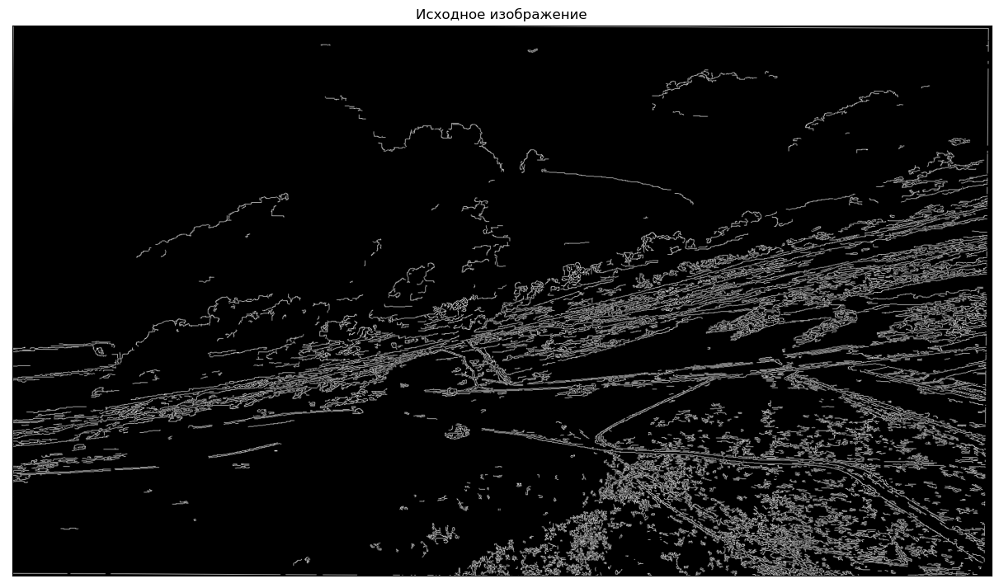

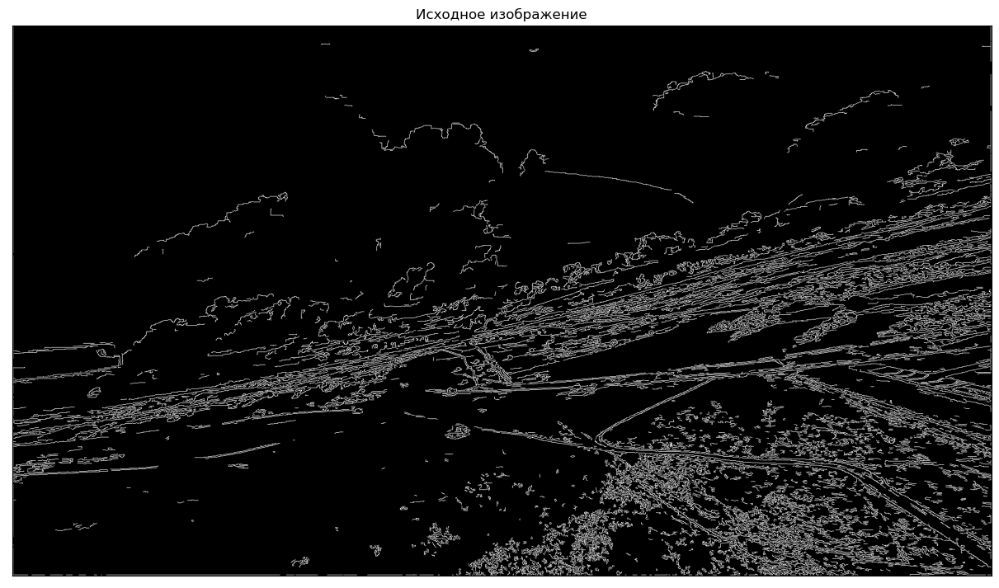

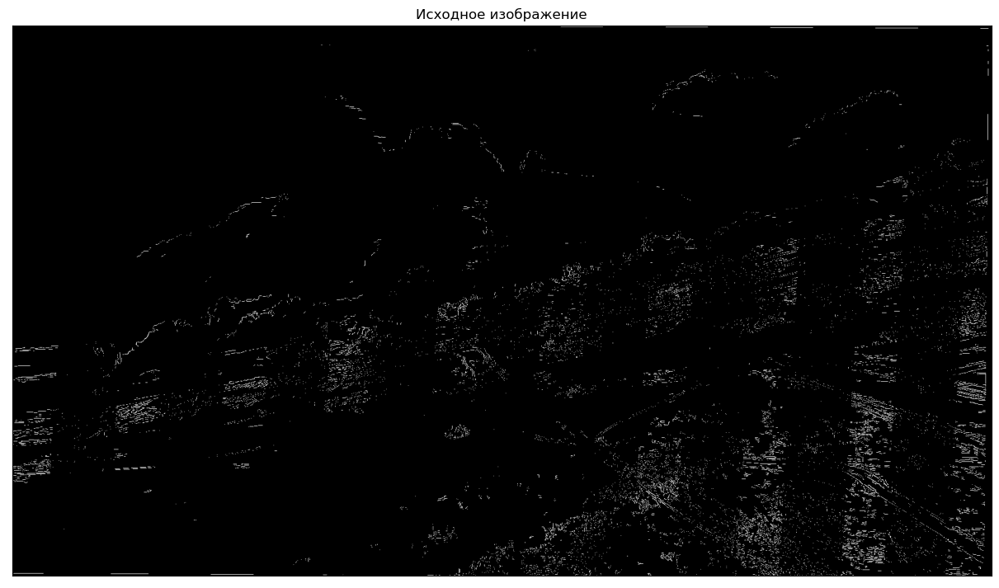

  0%|                                                                               | 1/1799 [00:04<2:09:22,  4.32s/it]

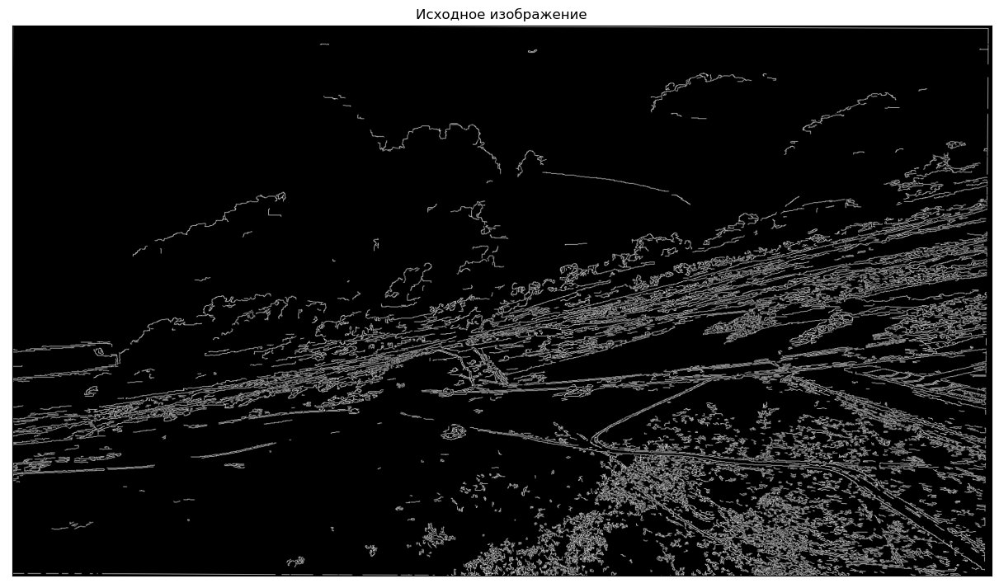

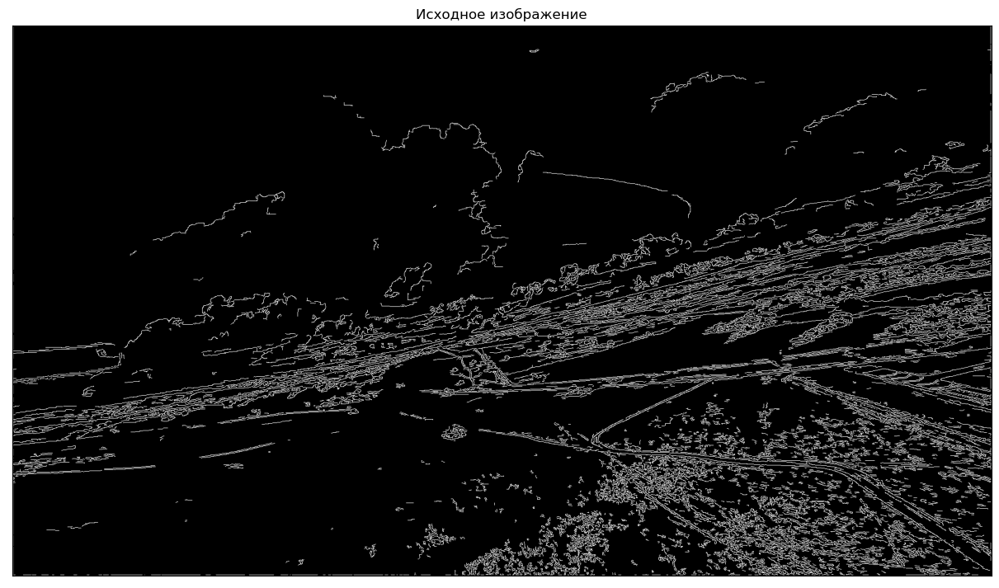

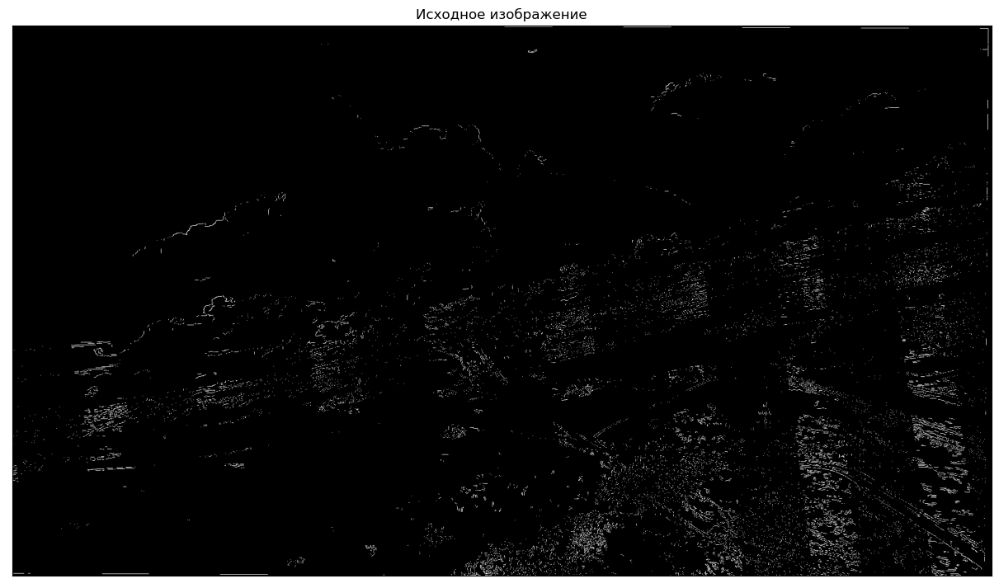

  0%|                                                                               | 2/1799 [00:08<2:09:06,  4.31s/it]

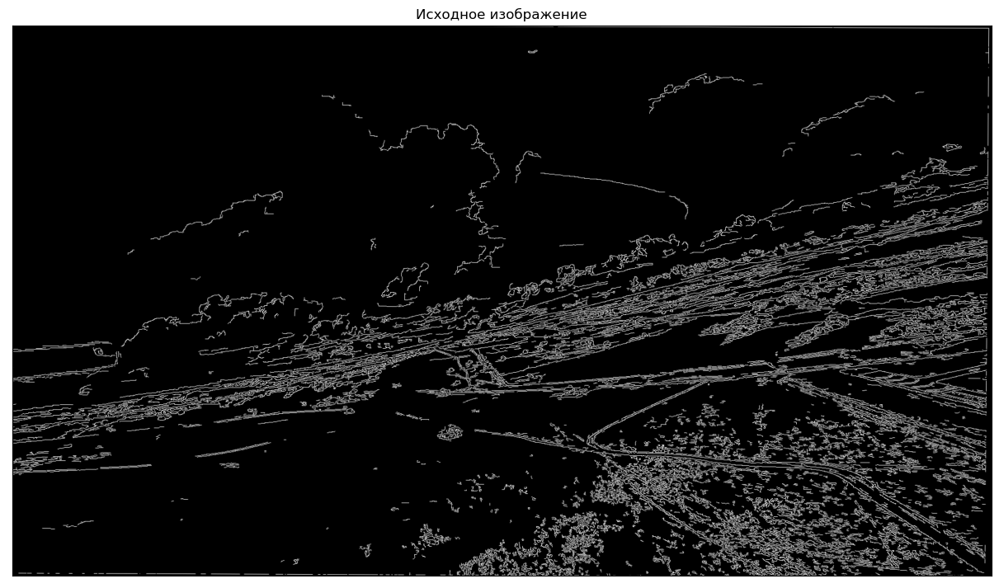

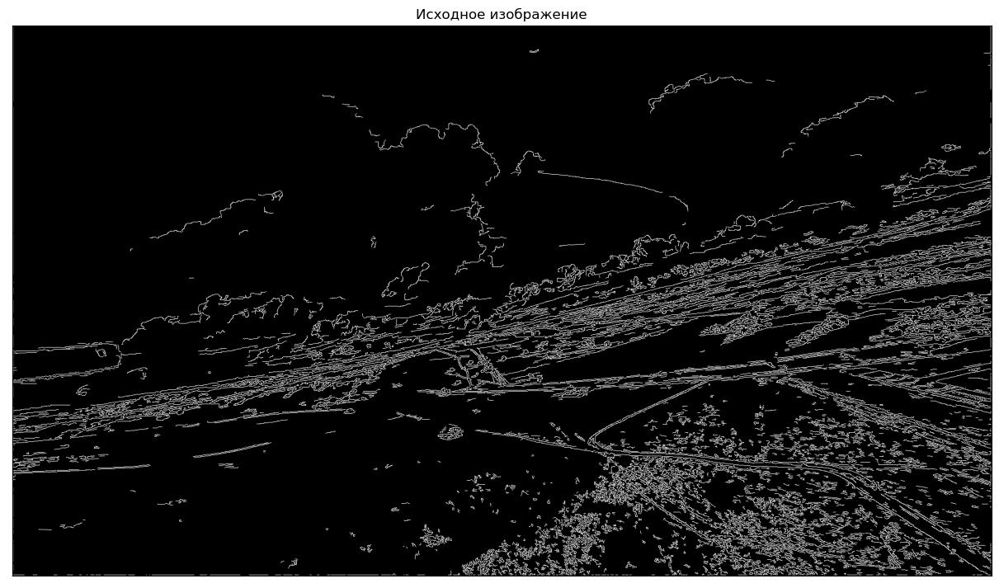

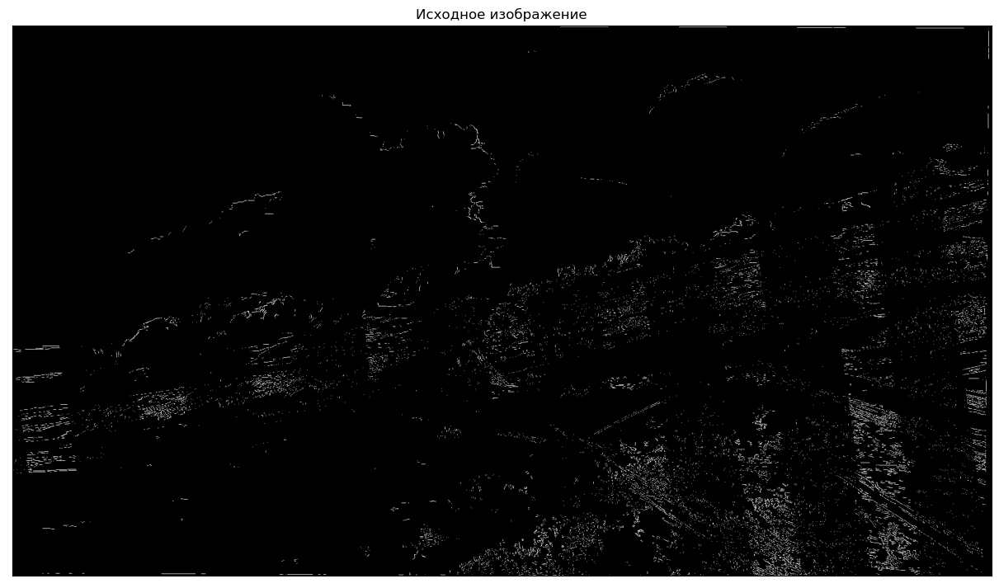

  0%|▏                                                                              | 3/1799 [00:12<2:05:57,  4.21s/it]

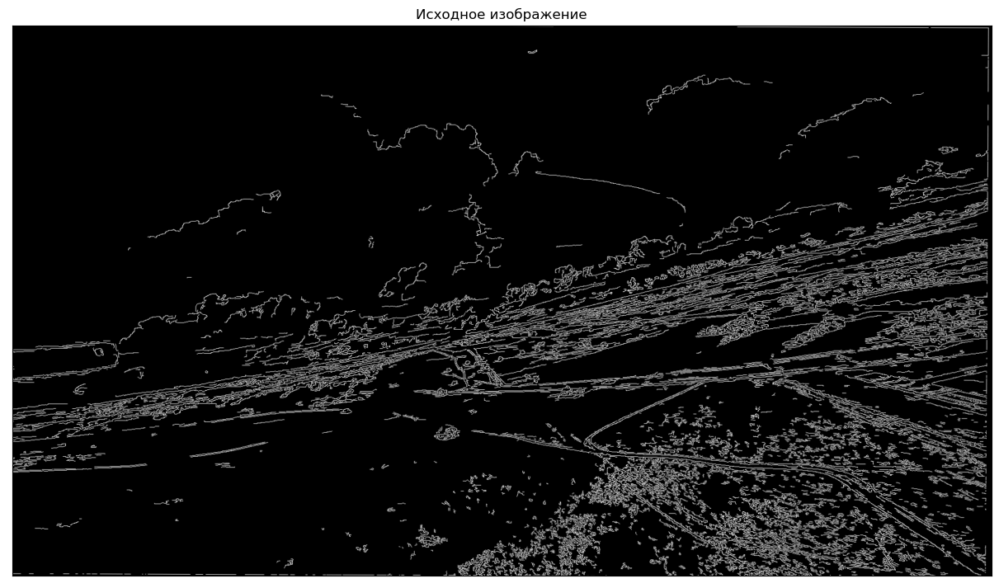

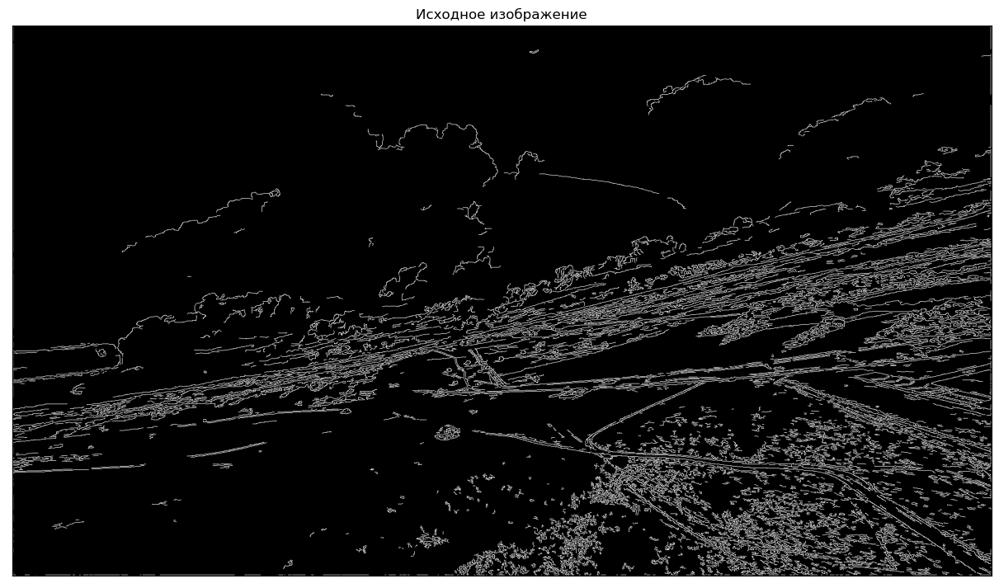

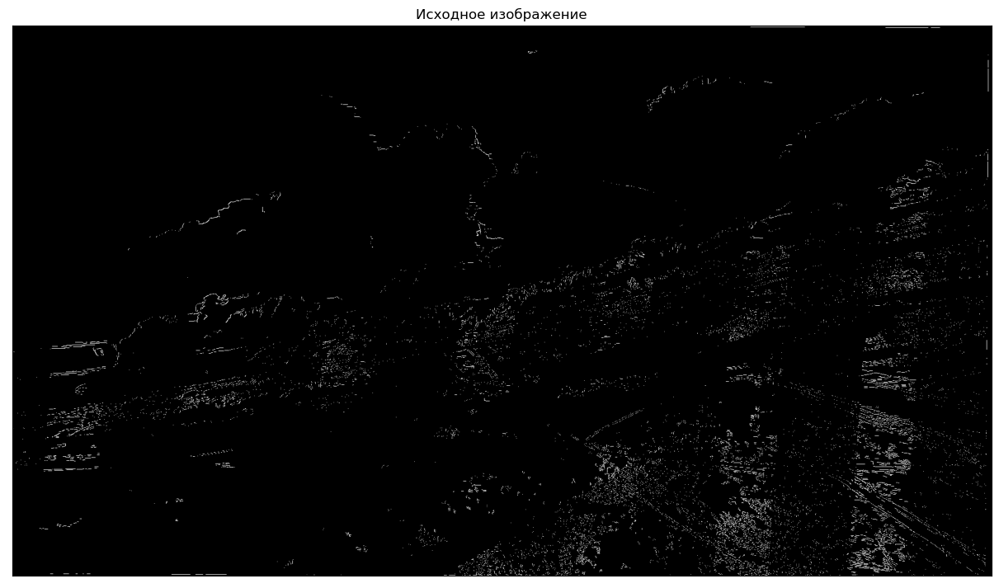

  0%|▏                                                                              | 4/1799 [00:16<2:04:33,  4.16s/it]

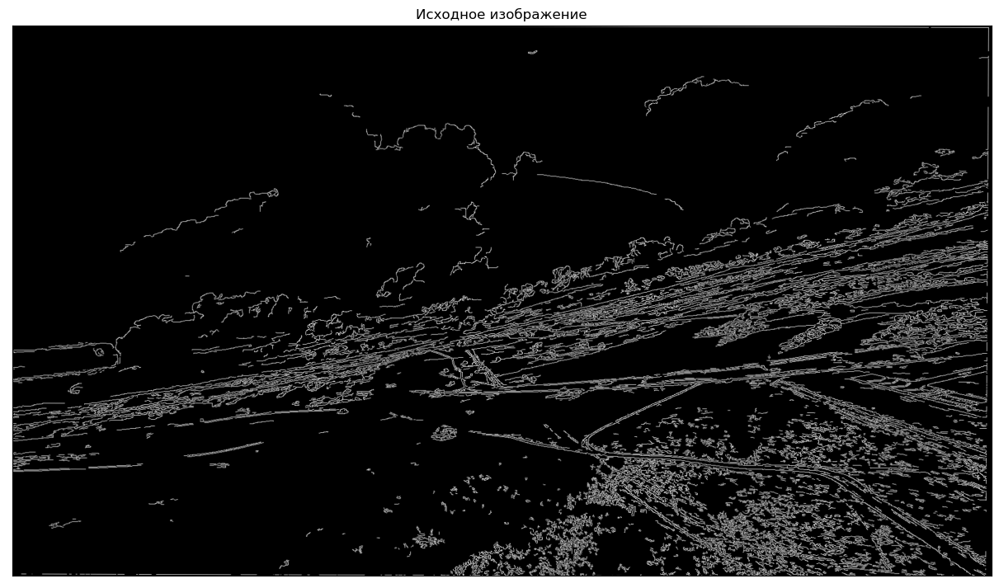

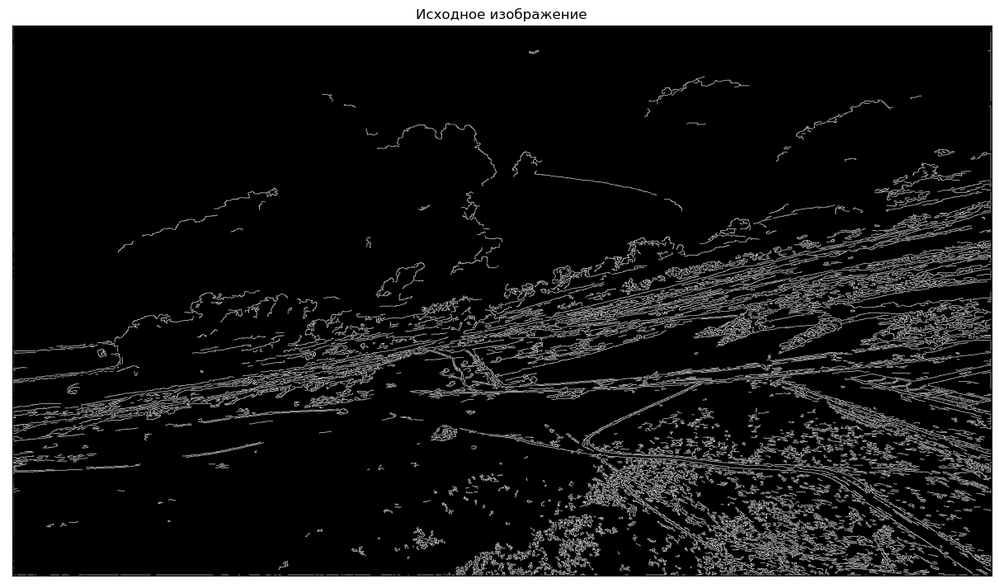

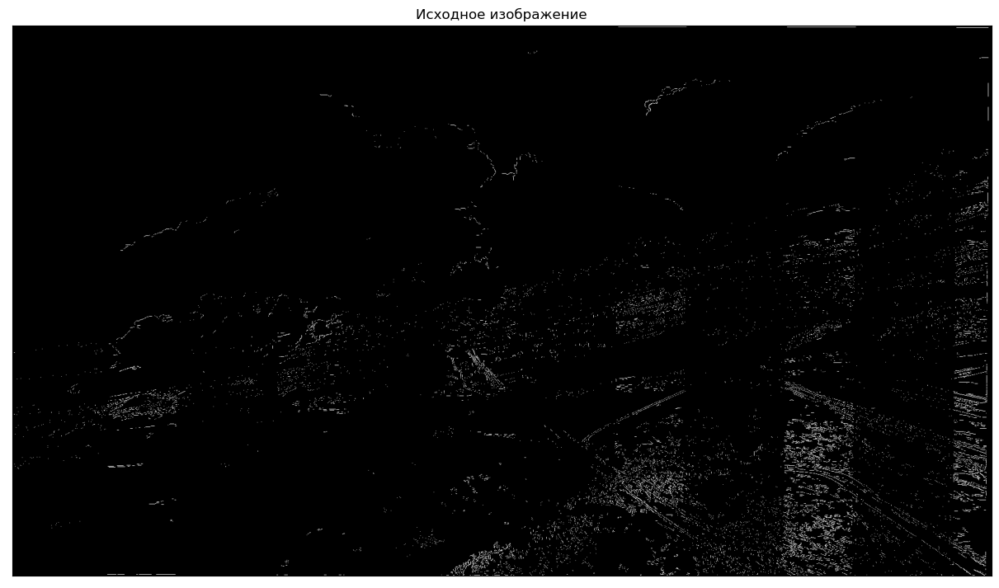

  0%|▏                                                                              | 5/1799 [00:20<2:03:35,  4.13s/it]

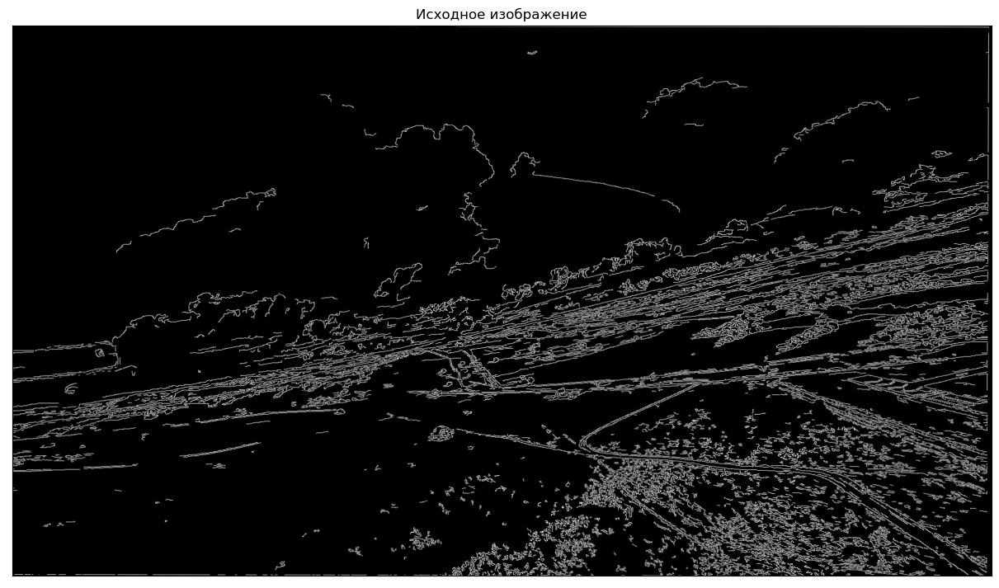

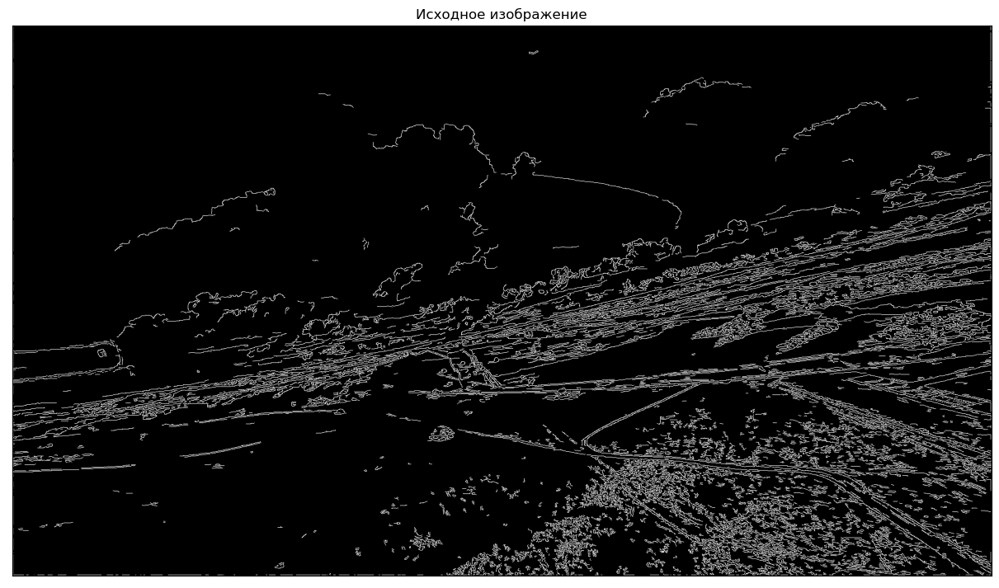

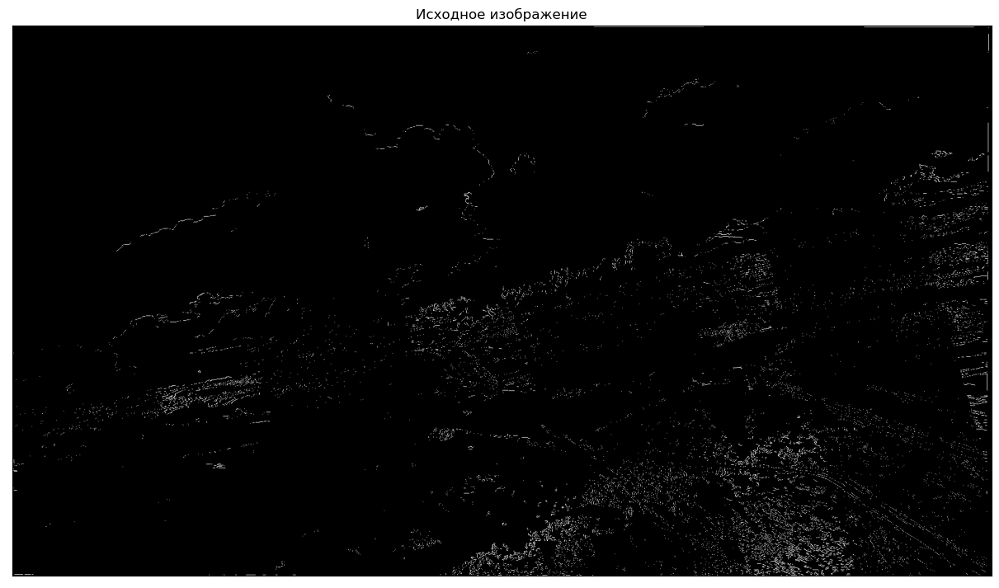

  0%|▎                                                                              | 6/1799 [00:25<2:03:26,  4.13s/it]

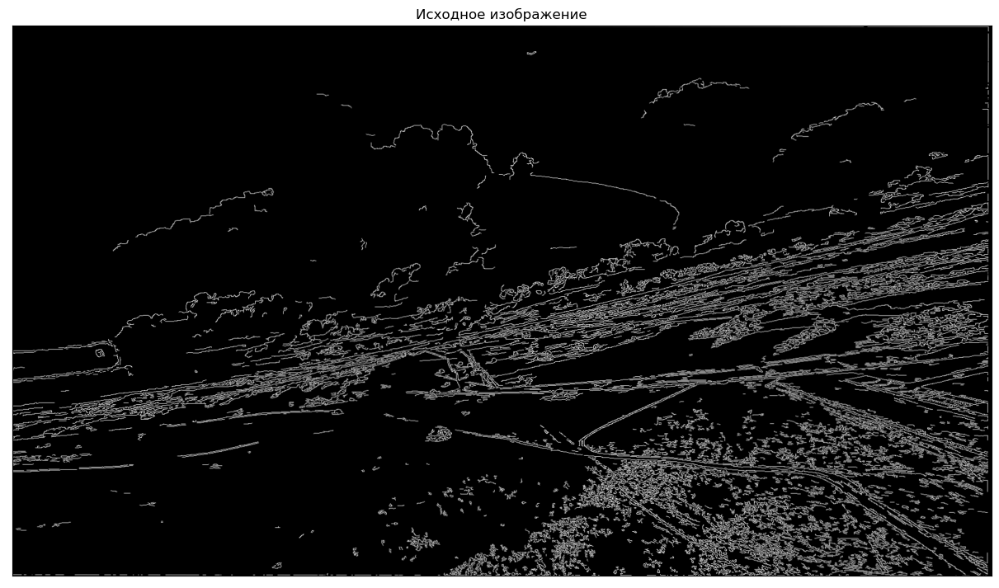

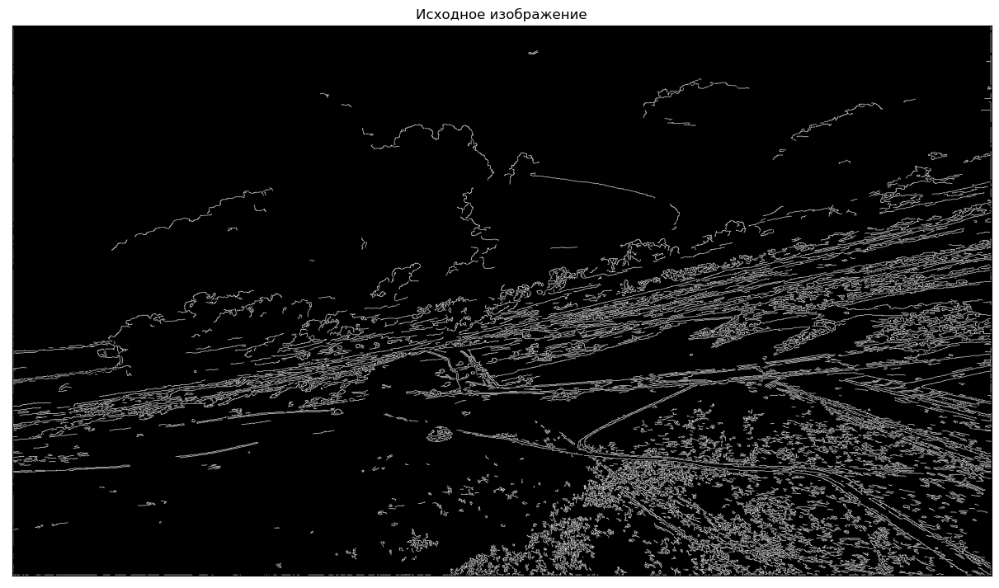

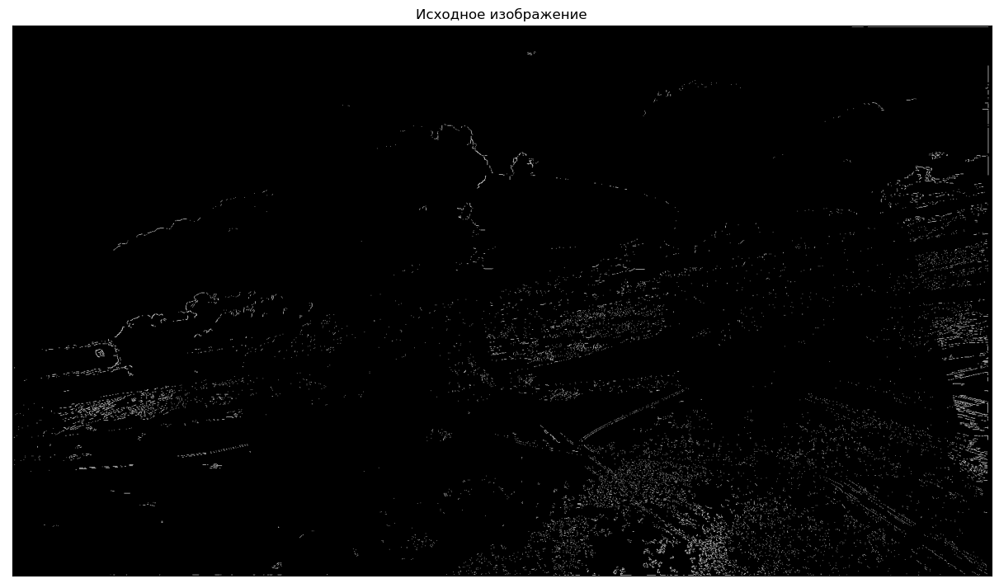

  0%|▎                                                                              | 7/1799 [00:29<2:02:16,  4.09s/it]

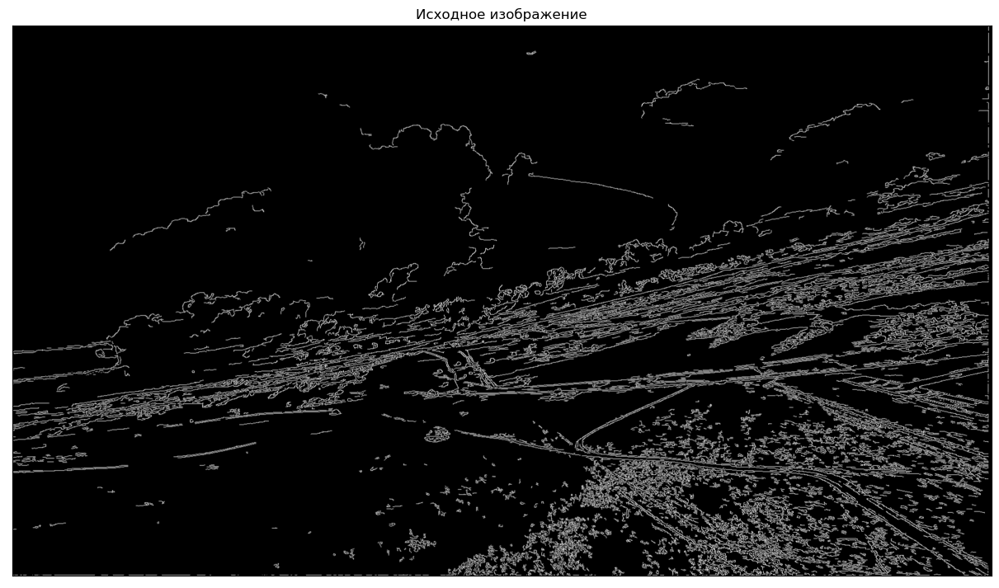

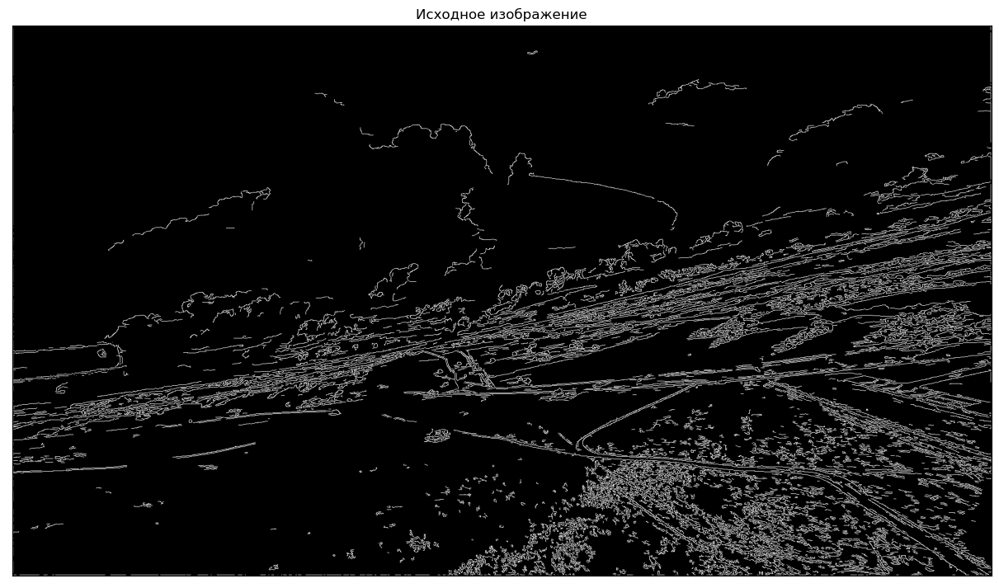

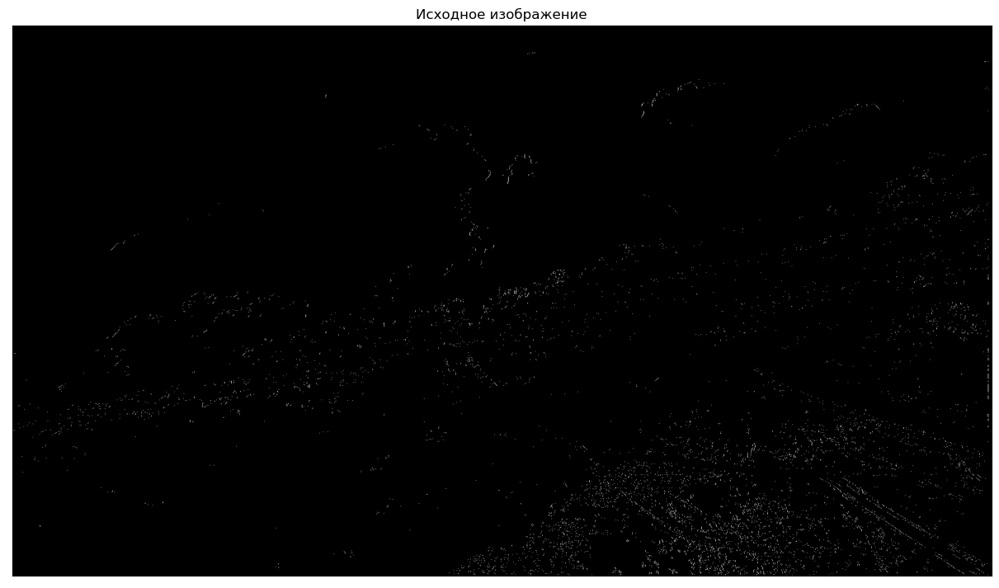

  0%|▎                                                                              | 8/1799 [00:33<2:01:02,  4.06s/it]

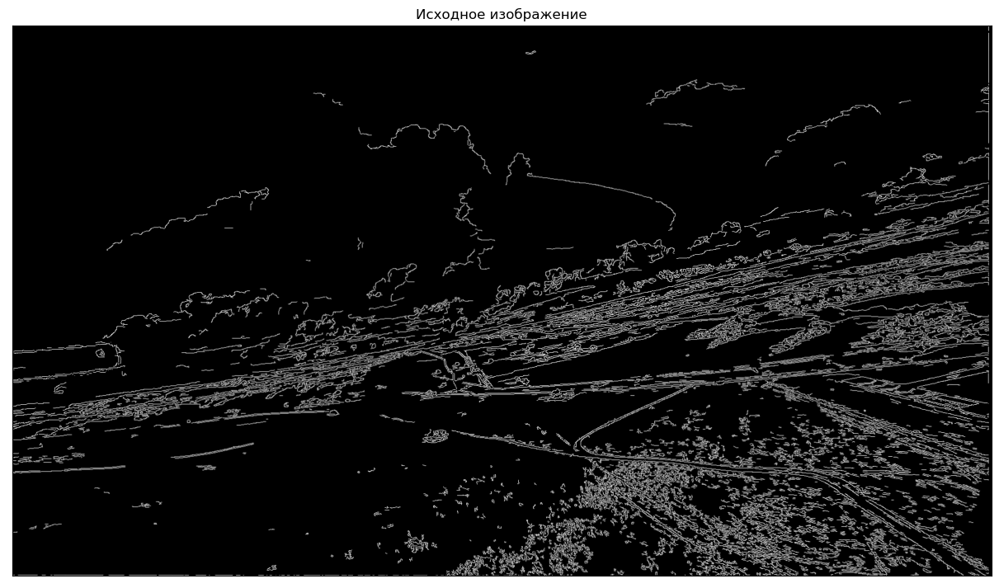

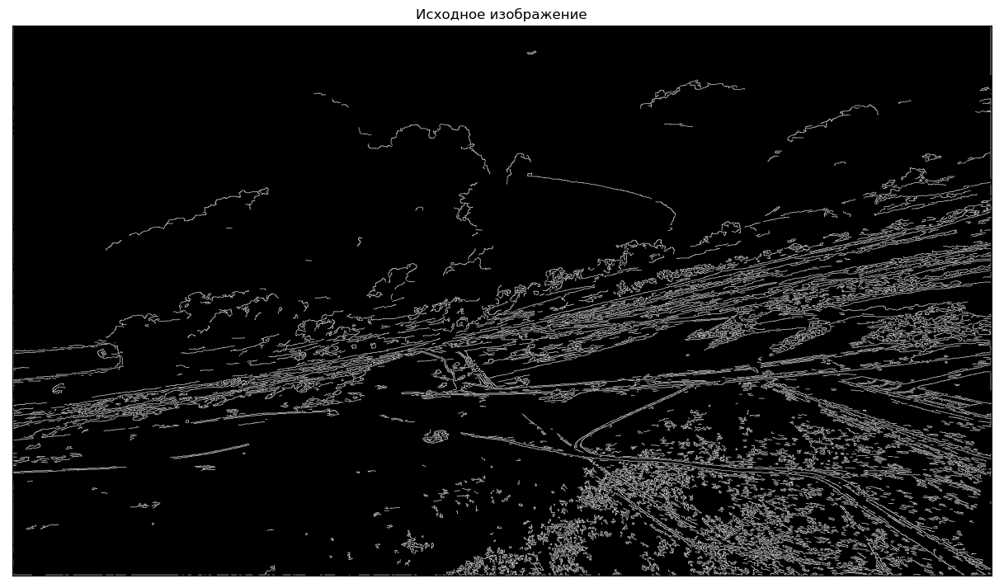

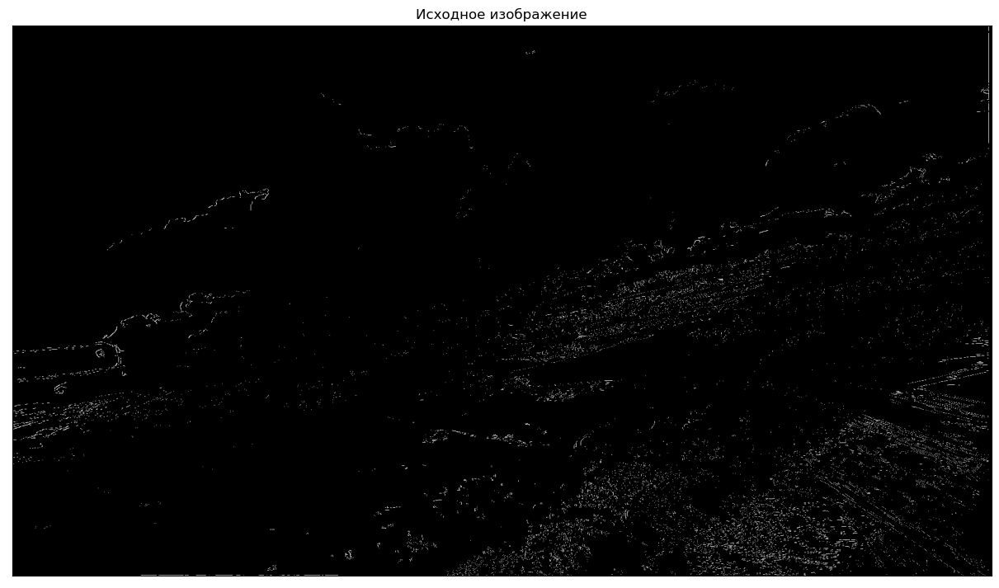

  1%|▍                                                                              | 9/1799 [00:36<2:00:24,  4.04s/it]

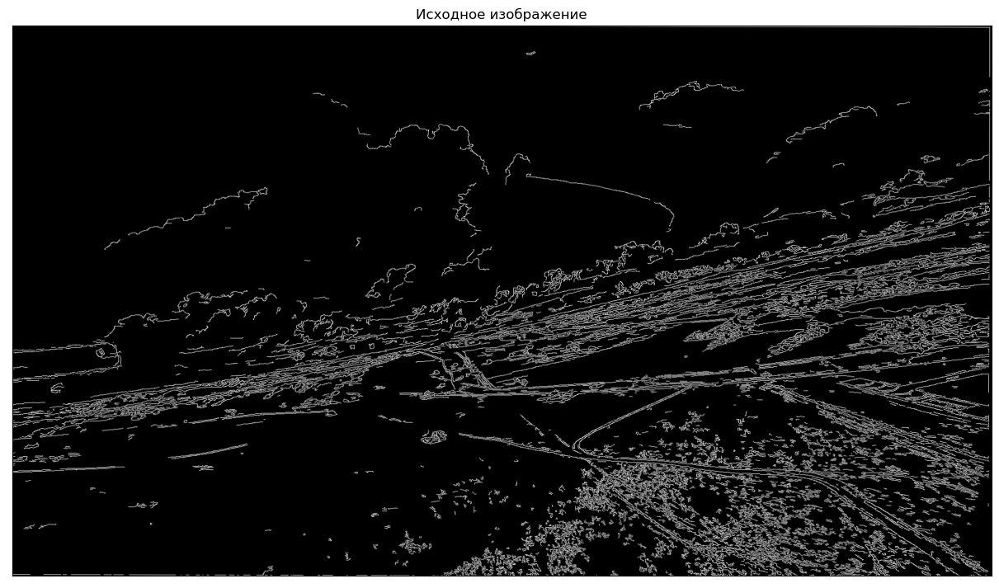

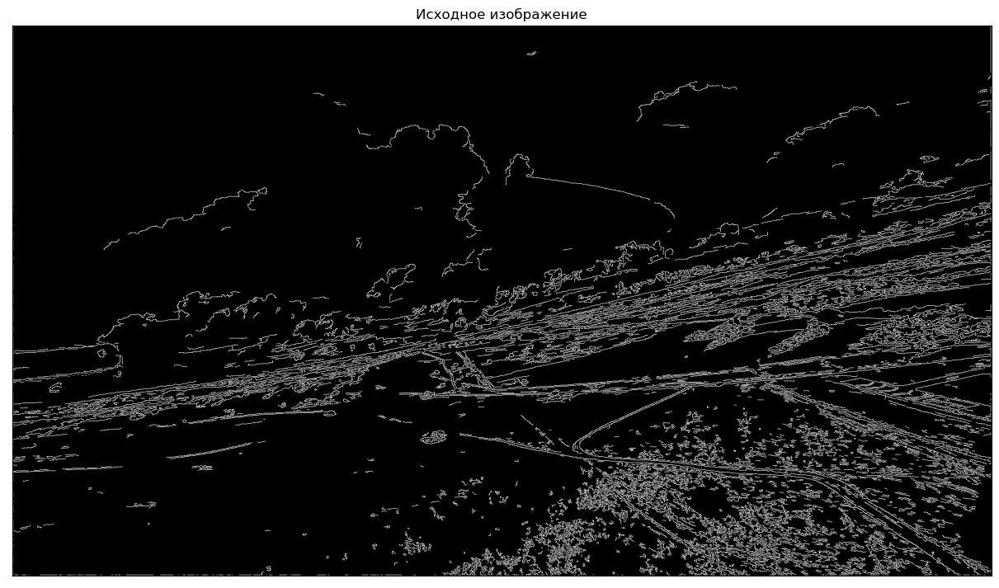

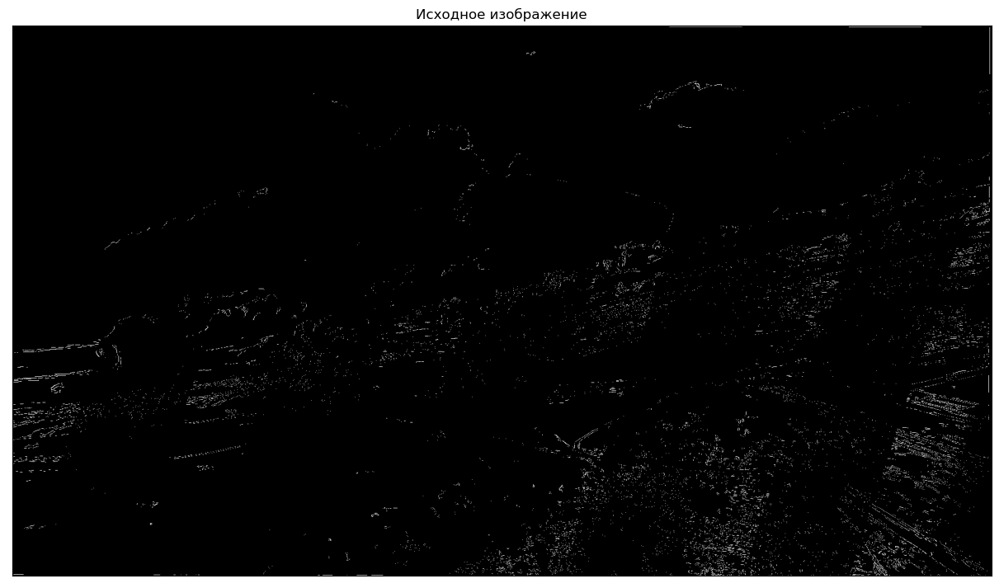

  1%|▍                                                                             | 10/1799 [00:41<2:02:38,  4.11s/it]

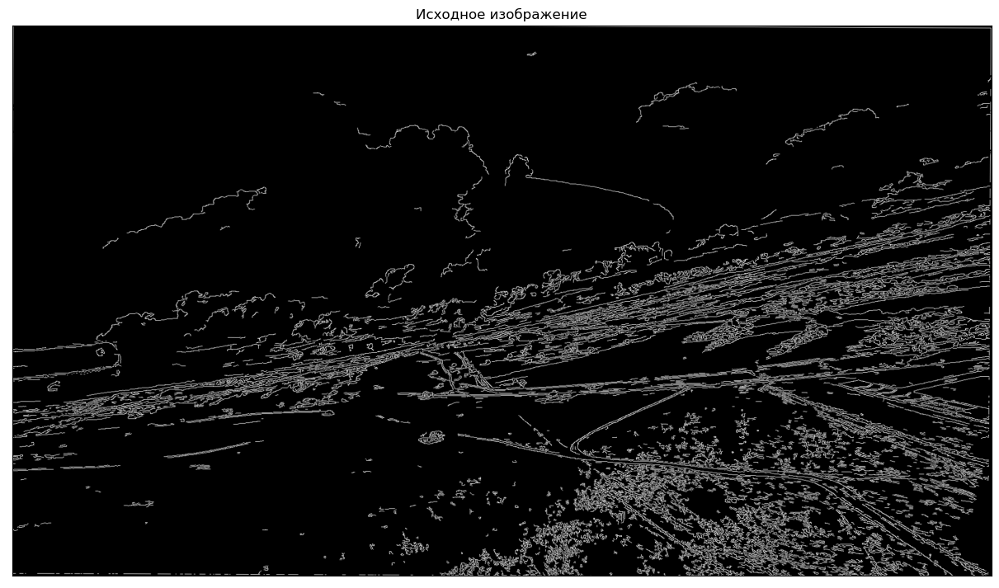

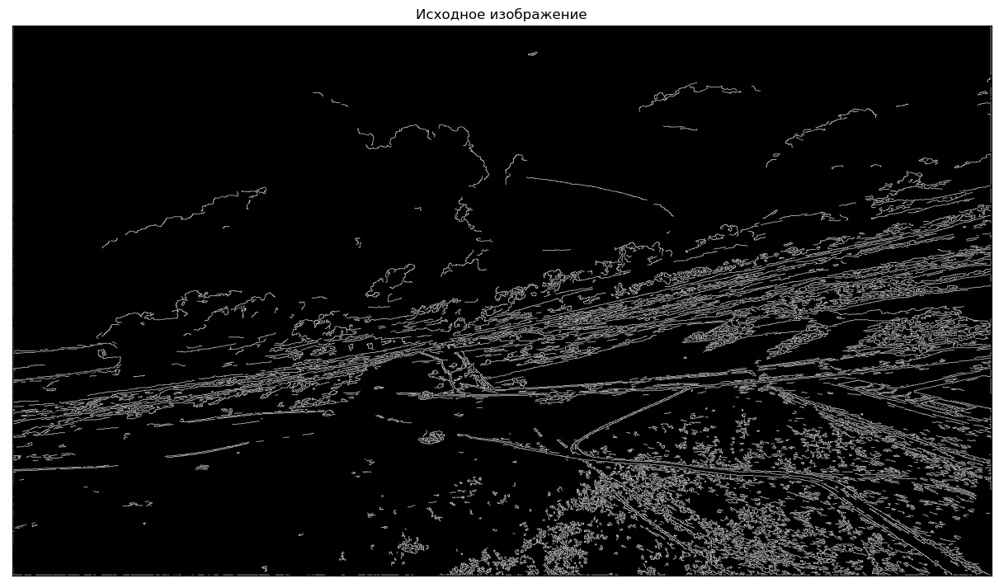

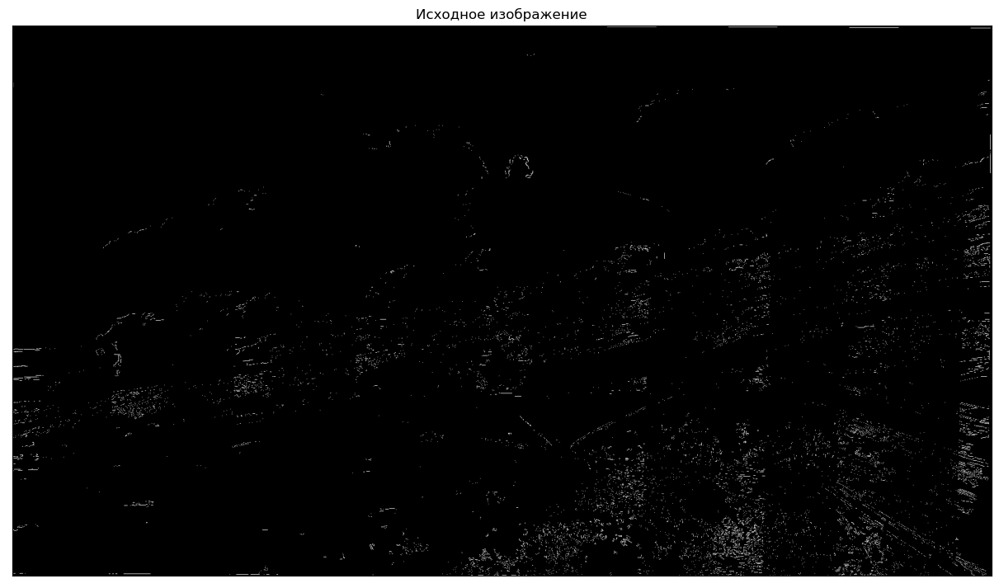

  1%|▍                                                                             | 11/1799 [00:45<2:01:16,  4.07s/it]

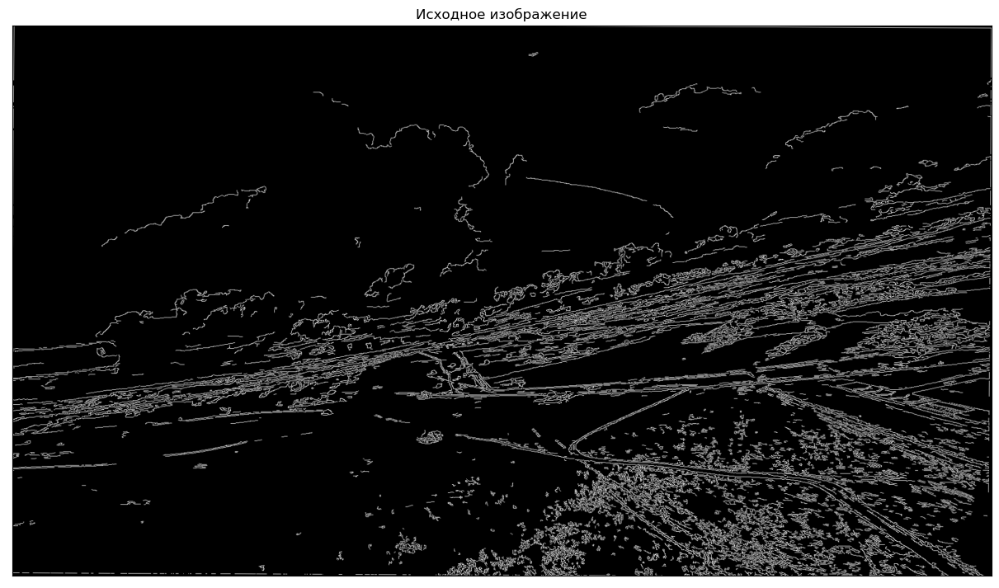

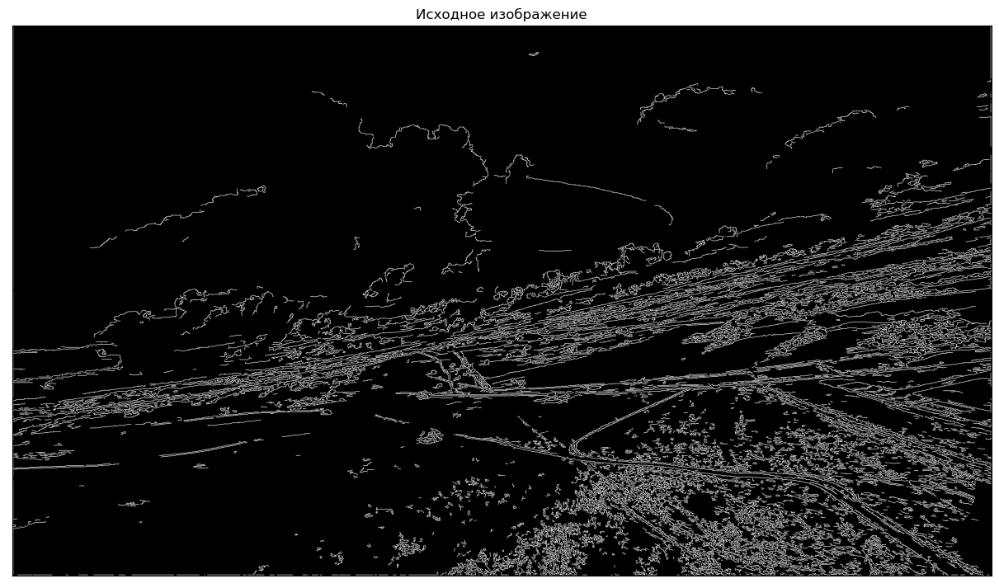

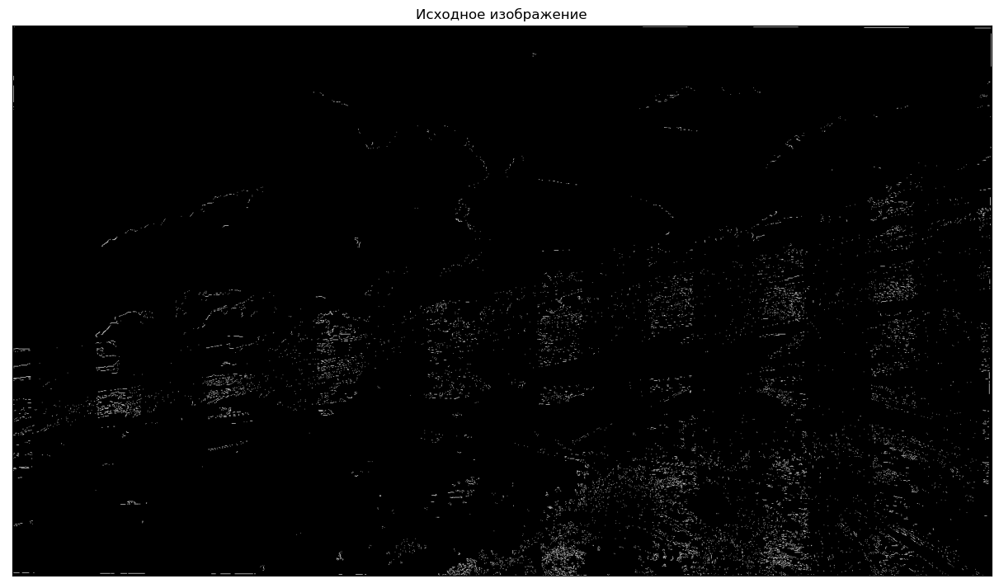

  1%|▌                                                                             | 12/1799 [00:49<1:59:43,  4.02s/it]

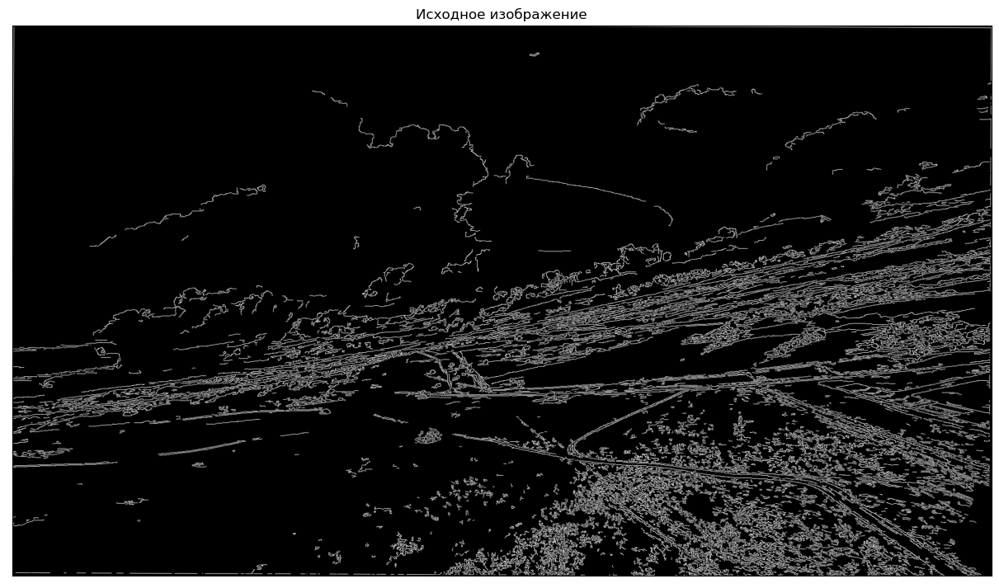

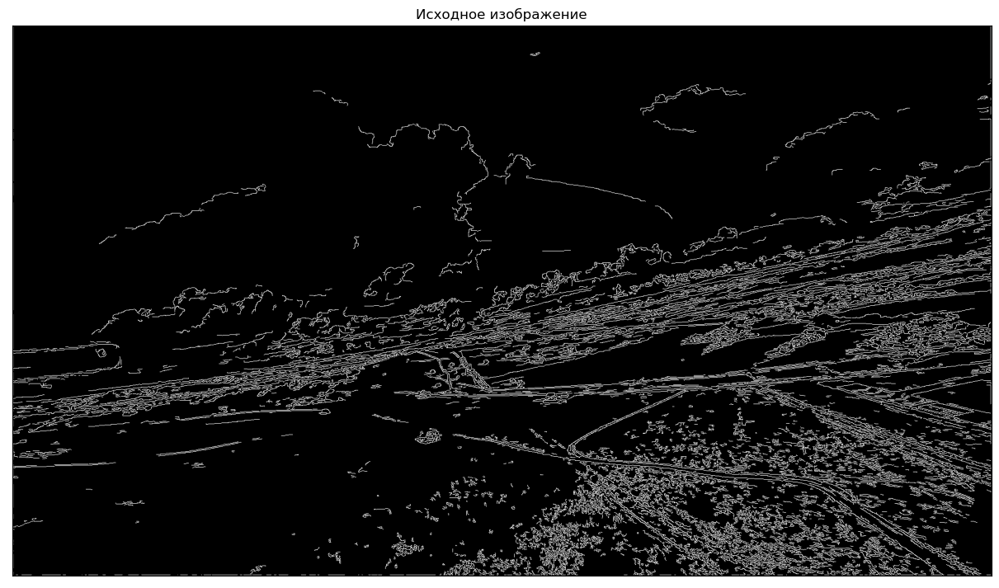

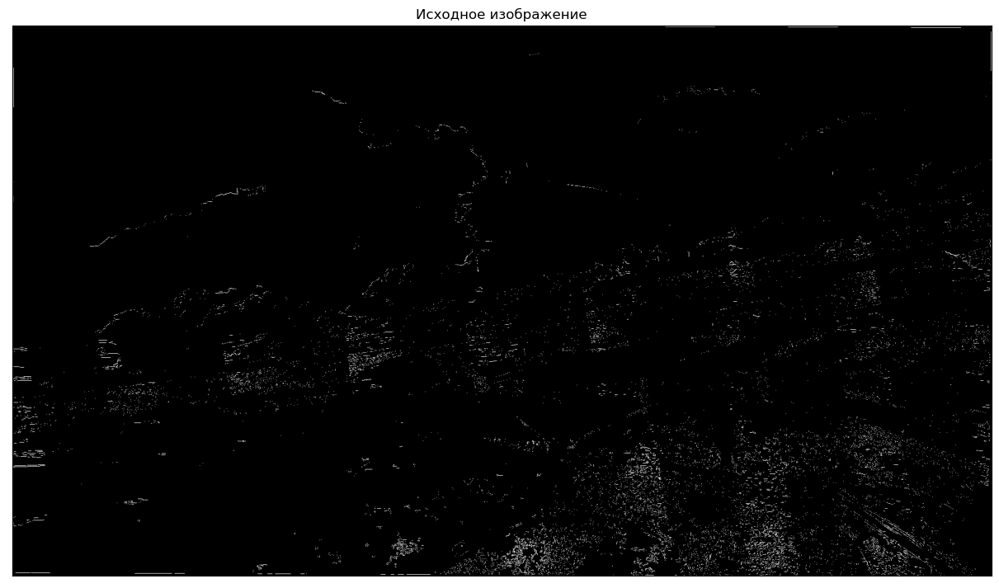

  1%|▌                                                                             | 13/1799 [00:52<1:58:03,  3.97s/it]

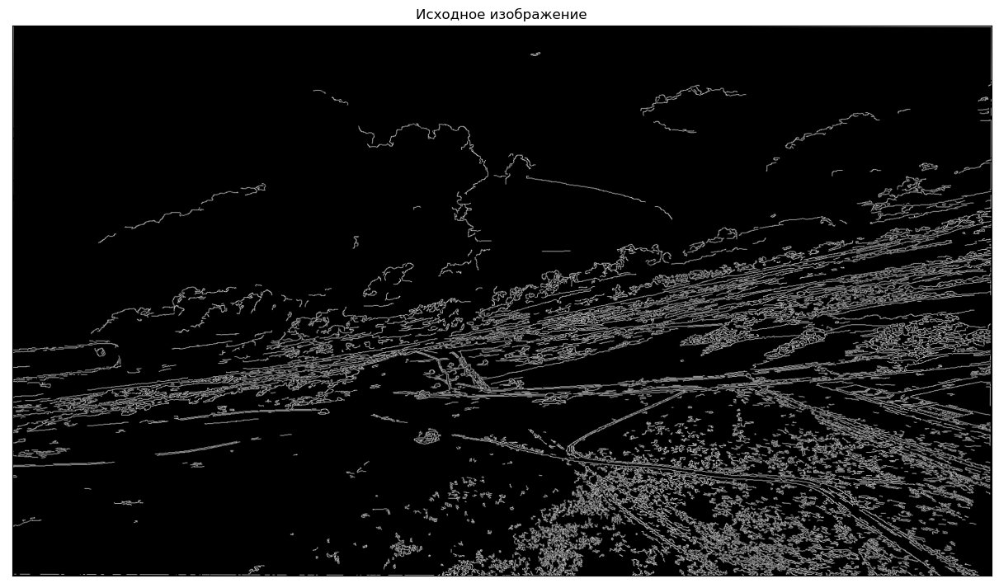

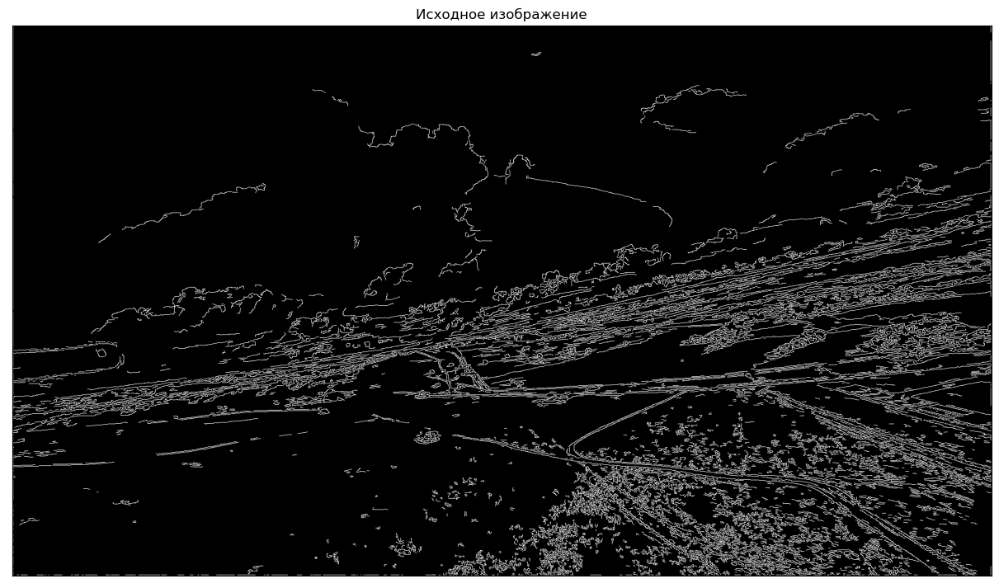

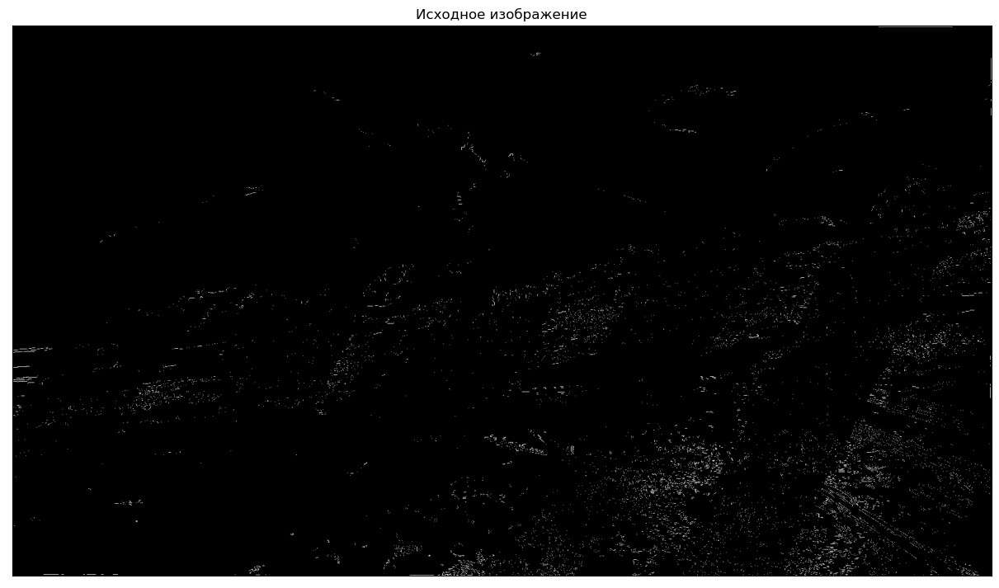

  1%|▌                                                                             | 14/1799 [00:56<1:57:19,  3.94s/it]

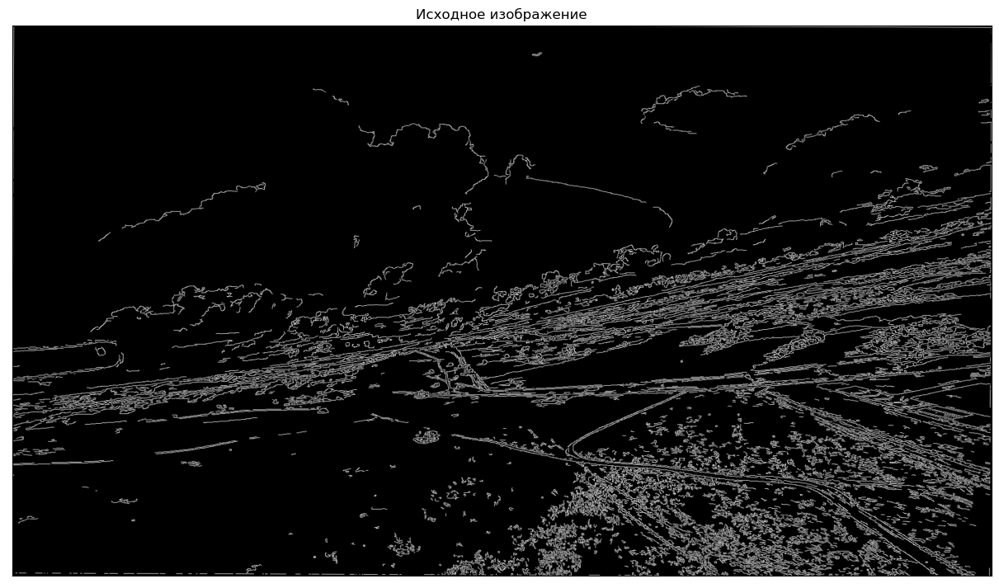

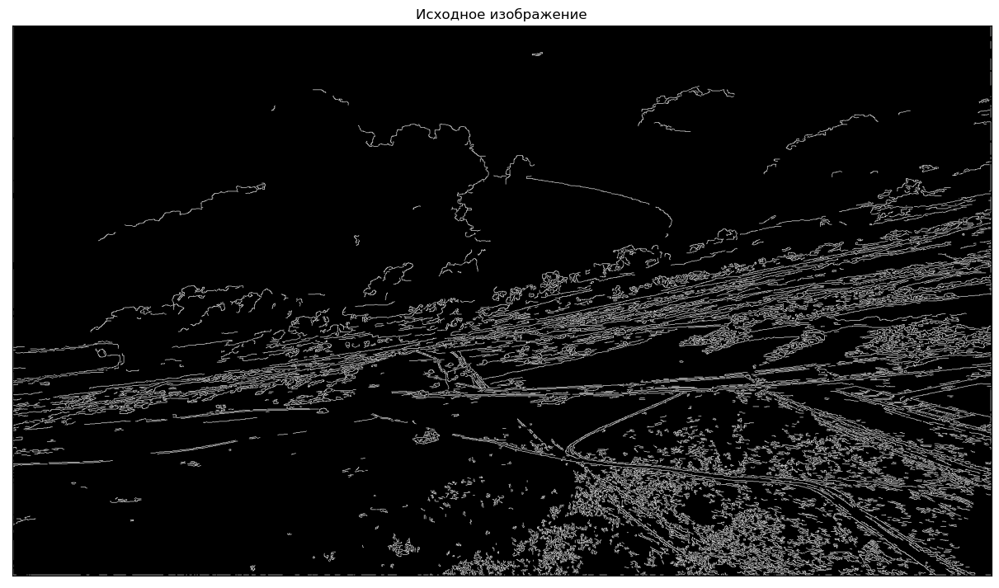

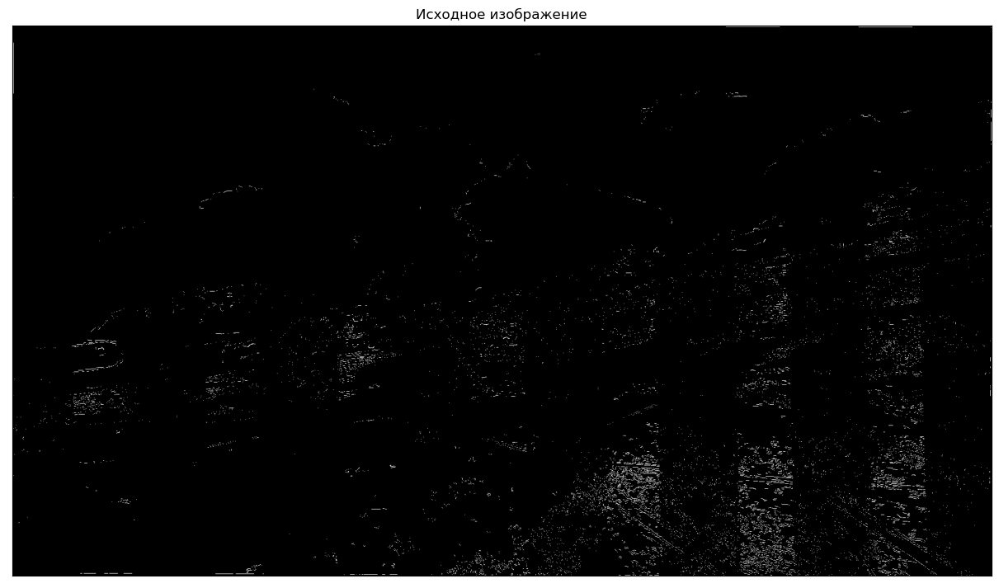

  1%|▋                                                                             | 15/1799 [01:00<1:57:16,  3.94s/it]

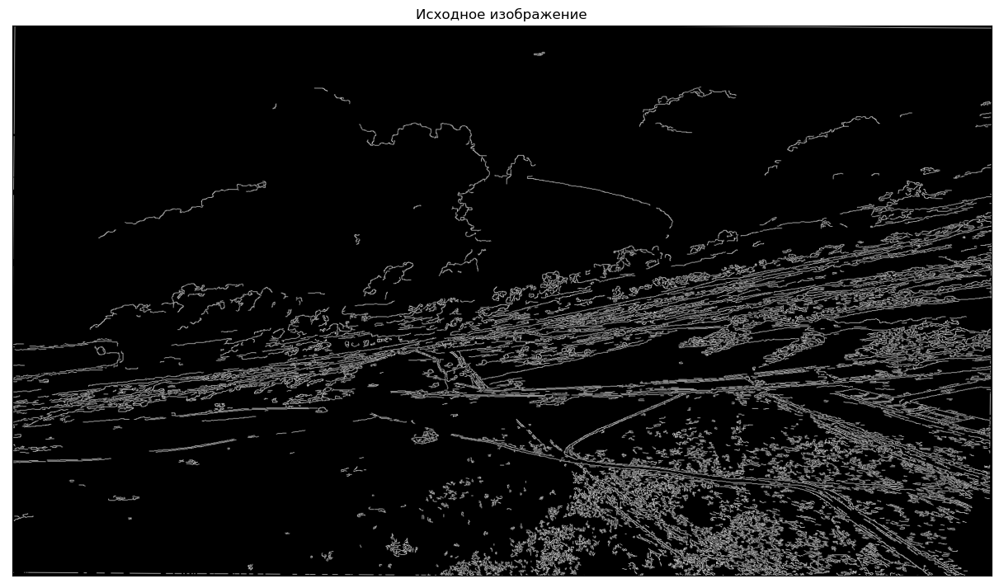

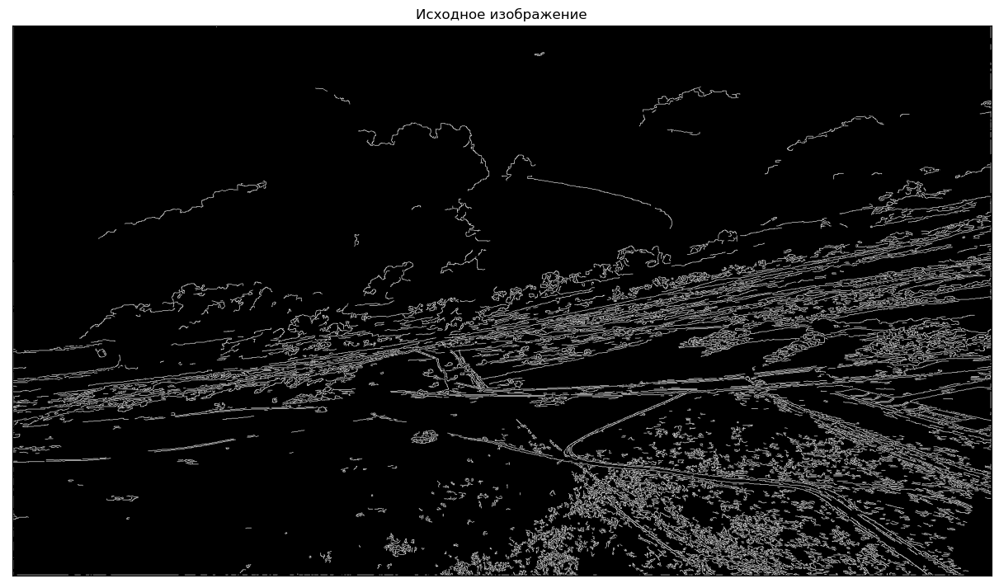

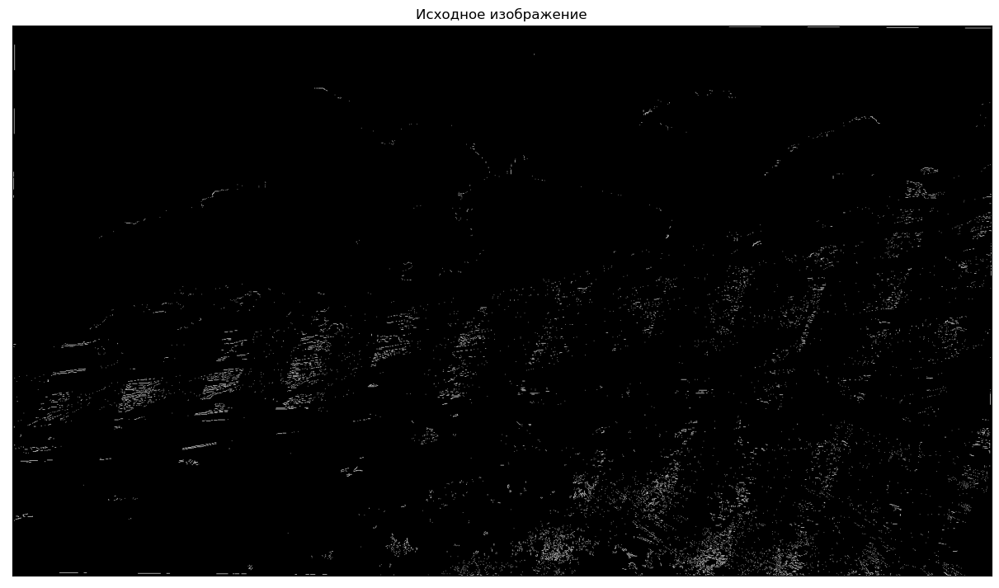

  1%|▋                                                                             | 16/1799 [01:04<1:55:56,  3.90s/it]

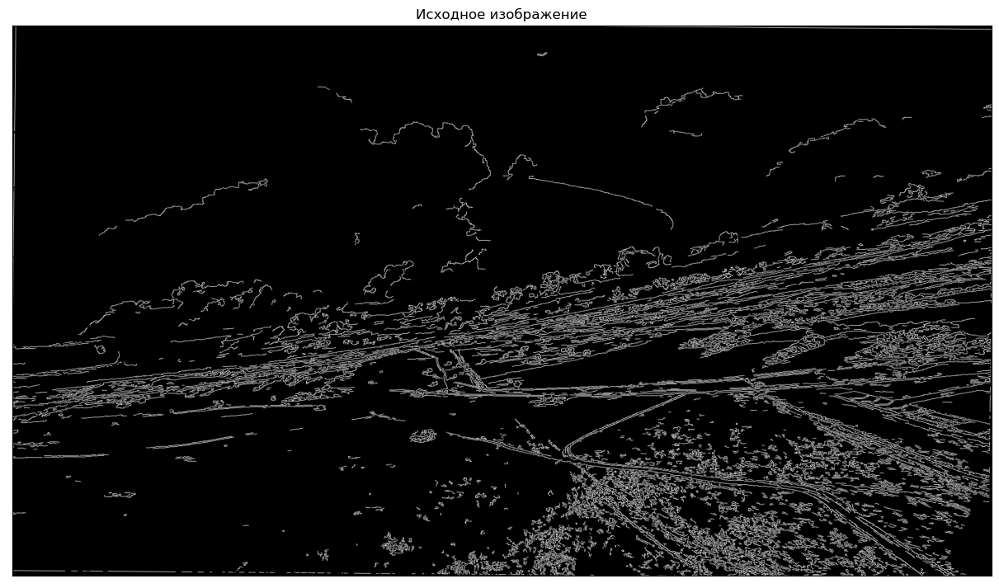

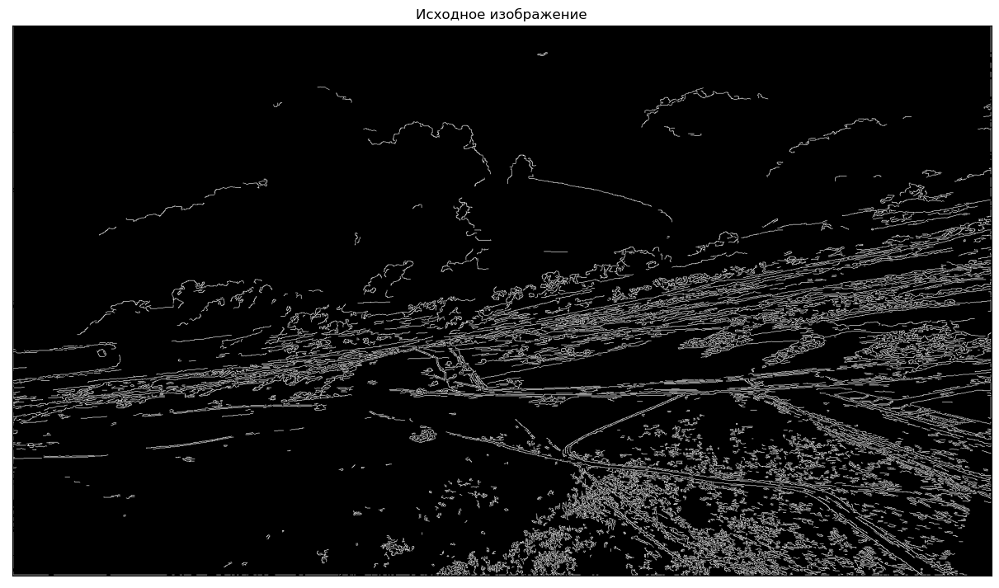

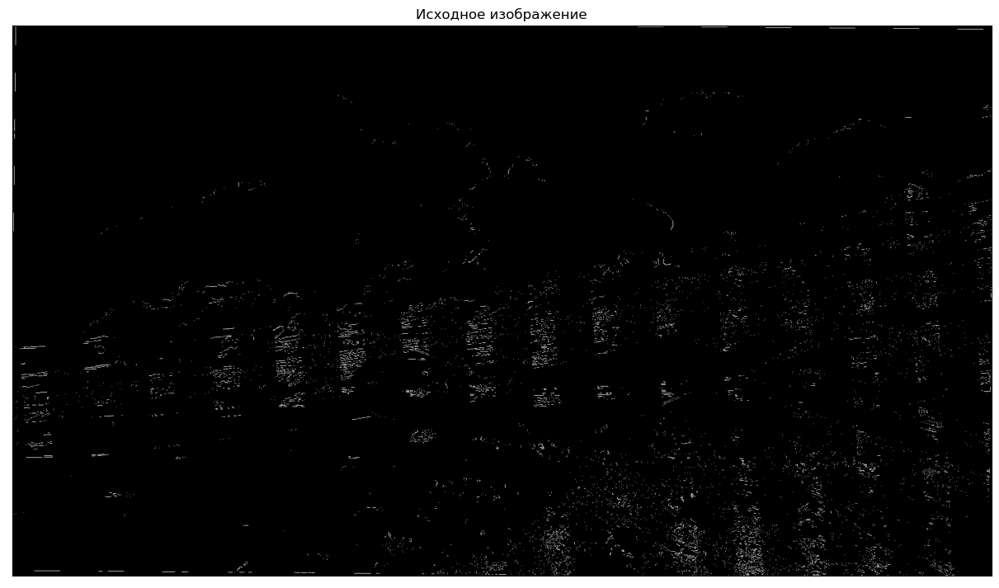

  1%|▋                                                                             | 17/1799 [01:08<1:56:14,  3.91s/it]

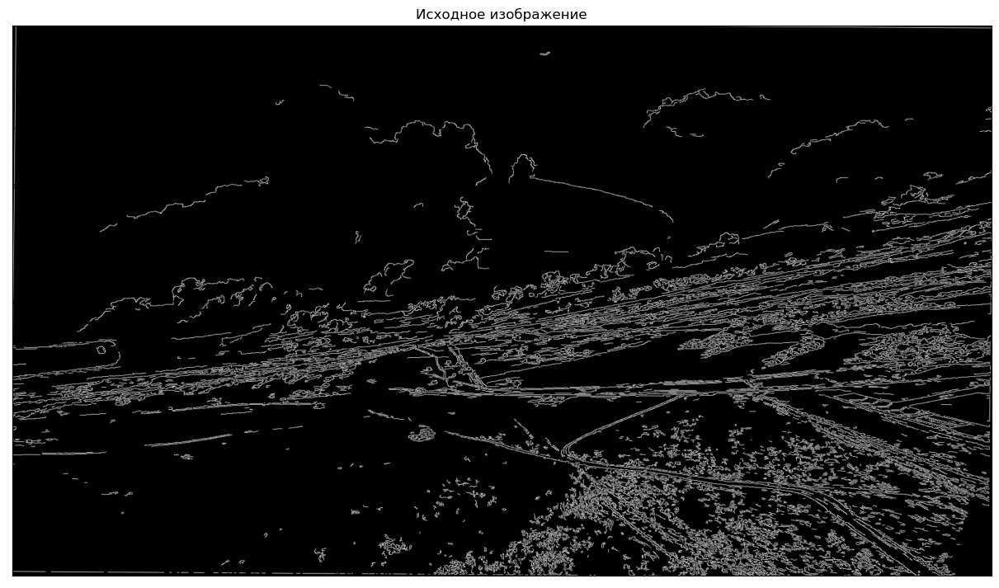

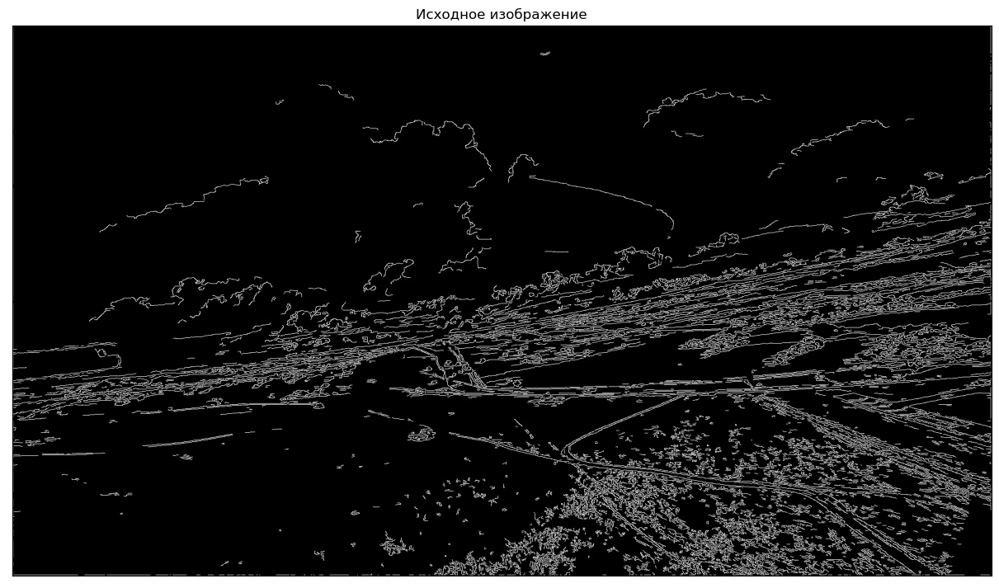

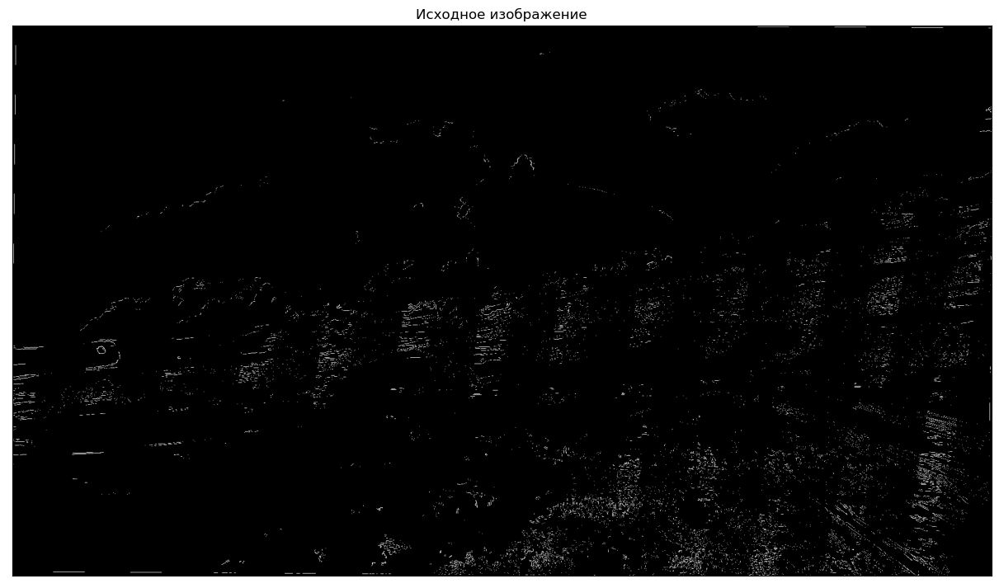

  1%|▊                                                                             | 18/1799 [01:15<2:03:51,  4.17s/it]

KeyboardInterrupt



In [258]:
cap = get_video(file_name='Clip_05.mov')
list_frames, all_time = get_trajectory(cap, model, an_w, an_h, 400, True)

In [230]:
# cap = get_video('Clip_01.mov')
# trajectories, list_frames, all_time = get_trajectory(cap, model, an_w, an_h, 400, True)
# # create_video('tmp', size=np.array((1920.0 , 1080.0)), vido_format='mp4')


In [184]:
print(all_time)
print(all_time/309)

1708.1440114974976
5.527974147241093


In [185]:
create_video('tmp2', size=np.array((1920.0 , 1080.0)), vido_format='mp4')

  0%|          | 0/401 [00:00<?, ?it/s]

In [186]:
show_video(path='./tmp2/', sleep=0.1)

tmp2.mp4
401.0 1920.0 1080.0 20.0


In [ ]:
draw_trajectories(list_frames, trajectories)

In [450]:
tr_lens = trajectories.get_trajectories_len()
tr_dist = trajectories.get_trajectories_dist()
print('count trajectories', len(tr_lens))
tr_dist = tr_dist[tr_lens > 5]
print('count normal trajectories', len(tr_dist))
print('dists', np.unique(tr_dist))

SyntaxError: invalid syntax. Perhaps you forgot a comma? (1903323218.py, line 5)

In [401]:
np.unique(tr_lens)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30])

In [22]:
create_video('tmp', size=np.array((1920.0 , 1080.0)), vido_format='mp4')

  0%|          | 0/401 [00:00<?, ?it/s]

In [23]:
show_video(path='./tmp2/', sleep=0.1)

tmp2.mp4
101.0 1920.0 1080.0 20.0


In [11]:
show_video(0, './Videos/Videos/', 1)

['Clip_1.mov', 'Clip_10.mov', 'Clip_11.mov', 'Clip_2.mov', 'Clip_3.mov', 'Clip_37.mov', 'Clip_4.mov', 'Clip_5.mov', 'Clip_6.mov', 'Clip_7.mov', 'Clip_8.mov', 'Clip_9.mov']
./Videos/Videos/Clip_1.mov
309.0 1920.0 1080.0 29.97


KeyboardInterrupt: 

In [14]:
show_video(sleep=0.2)

['tmp.mp4']
./tmp/tmp.mp4
308.0 1920.0 1080.0 20.0


In [17]:
create_video('tmp', size=np.array((1920.0 , 1080.0)), vido_format='mov')
show_video(sleep=0.2)

  0%|          | 0/308 [00:00<?, ?it/s]

['tmp.mov']
./tmp/tmp.mov
308.0 1920.0 1080.0 20.0


In [381]:
for i in range(11):
    cap = get_video(i)
    get_video_details(cap)

309.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97
1800.0 1920.0 1080.0 29.97


In [165]:
a = range(11)
b = [3,5,6,10]
print(set(a) ^ set(b))
print(set(a) & set(b))

{0, 1, 2, 4, 7, 8, 9}
{10, 3, 5, 6}


In [58]:
from sklearn.cluster import AgglomerativeClustering

X = np.array([[1, 1], [1, 2], [2, 1], [2, 2],
              [3.1, 1], [3.1, 2], [4.1, 1], [4.1, 2],
              [1, 3.1], [1, 4.1], [2, 3.1], [2, 4.1]])
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=1.05, linkage='single').fit(X)
print(clustering)
print(clustering.labels_)

AgglomerativeClustering(distance_threshold=1.05, linkage='single',
                        n_clusters=None)
[2 2 2 2 1 1 1 1 0 0 0 0]


In [254]:
import seaborn as sns
list(sns.color_palette(None, 3).as_hex())

['#1f77b4', '#ff7f0e', '#2ca02c']

In [272]:
random.randrange(1,12)

6

In [32]:
X = np.array([[1, 1], [1, 2], [2, 1], [2, 2],
              [3.1, 1], [3.1, 2], [4.1, 1], [4.1, 2],
              [1, 3.1], [1, 4.1], [2, 3.1], [2, 4.1]])
pdist(X, 'euclidean')

array([1.        , 1.        , 1.41421356, 2.1       , 2.32594067,
       3.1       , 3.25729949, 2.1       , 3.1       , 2.32594067,
       3.25729949, 1.41421356, 1.        , 2.32594067, 2.1       ,
       3.25729949, 3.1       , 1.1       , 2.1       , 1.48660687,
       2.32594067, 1.        , 1.1       , 1.48660687, 2.1       ,
       2.32594067, 2.32594067, 3.25729949, 2.1       , 3.1       ,
       1.48660687, 1.1       , 2.32594067, 2.1       , 1.48660687,
       2.32594067, 1.1       , 2.1       , 1.        , 1.        ,
       1.41421356, 2.96984848, 3.74432905, 2.37065392, 3.28937684,
       1.41421356, 1.        , 2.37065392, 2.96984848, 1.55563492,
       2.37065392, 1.        , 3.74432905, 4.38406204, 2.96984848,
       3.74432905, 3.28937684, 3.74432905, 2.37065392, 2.96984848,
       1.        , 1.        , 1.41421356, 1.41421356, 1.        ,
       1.        ])

In [ ]:
cap = get_video(2)
nice_pic, gray = get_trajectory(cap, 400, True)

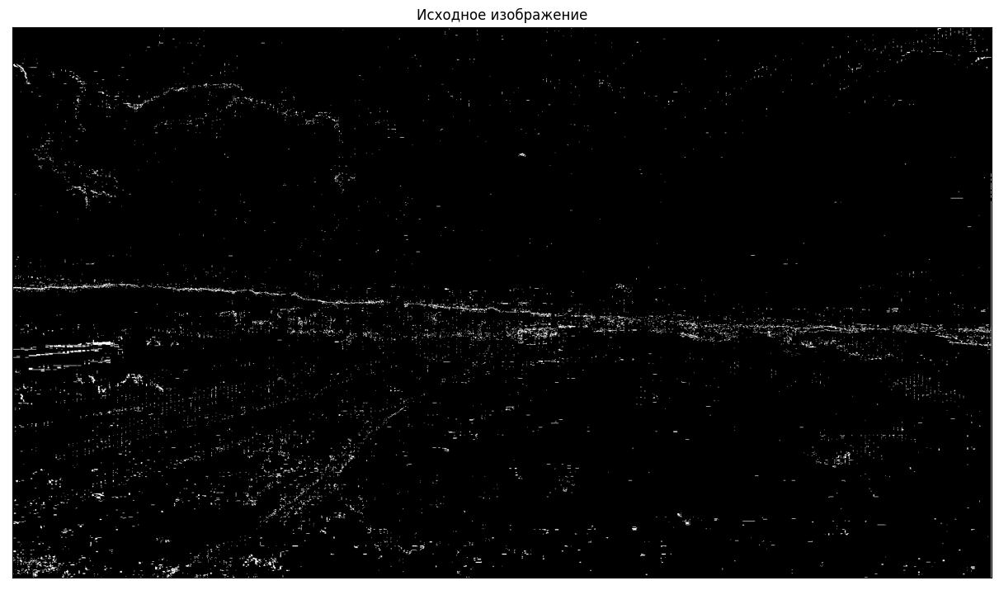

In [29]:
mask = np.uint8(nice_pic > 5)*255
plot_one_image(mask, True)

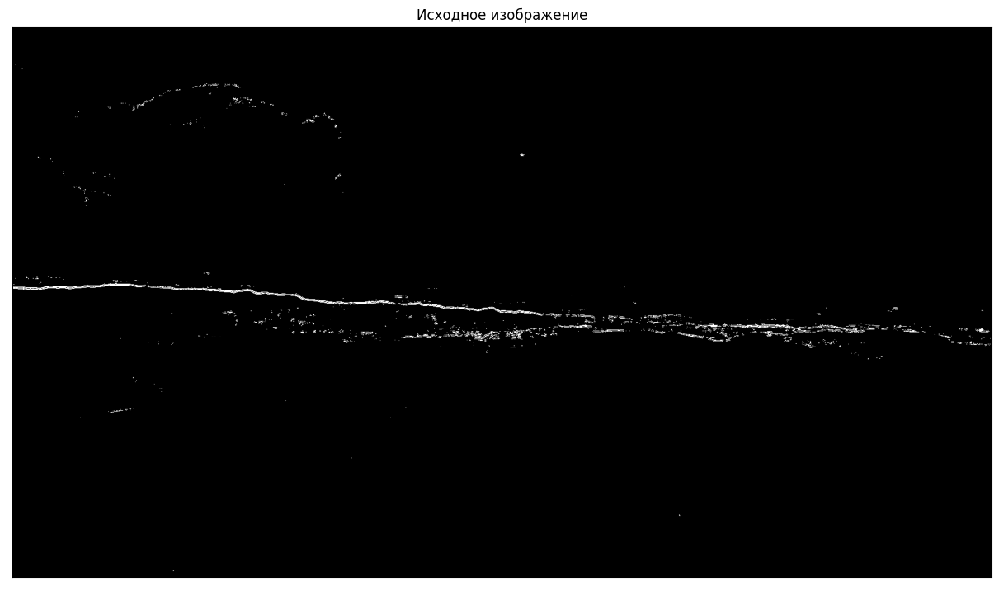

In [42]:
temp = cv2.GaussianBlur(gray, (3,3), 0)
temp2 = cv2.GaussianBlur(temp, (3,3), 0)
temp3 = cv2.GaussianBlur(temp2, (3,3), 0)
mask2 = np.uint8(np.abs(temp2.astype(int)-temp.astype(int)) > 3)*255
plot_one_image(mask2, True)

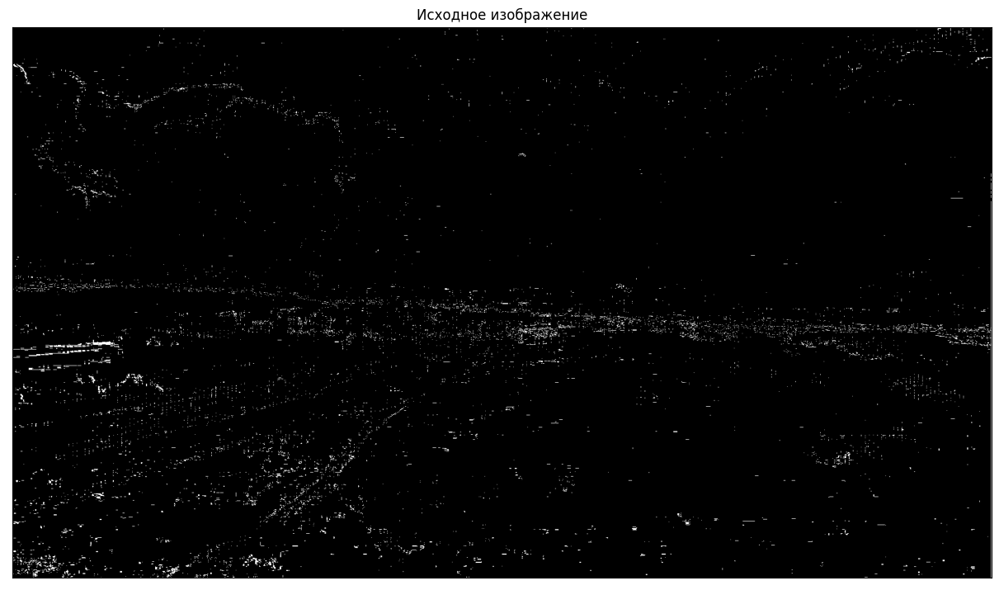

In [43]:
res = (mask != 0) & (mask2 == 0)
res = np.uint8(res)*255
plot_one_image(res, True)

In [23]:
cap = get_video(2)
frame = get_trajectory(cap, 100, True)

Clip_03.mov
1800.0 1920.0 1080.0 29.97


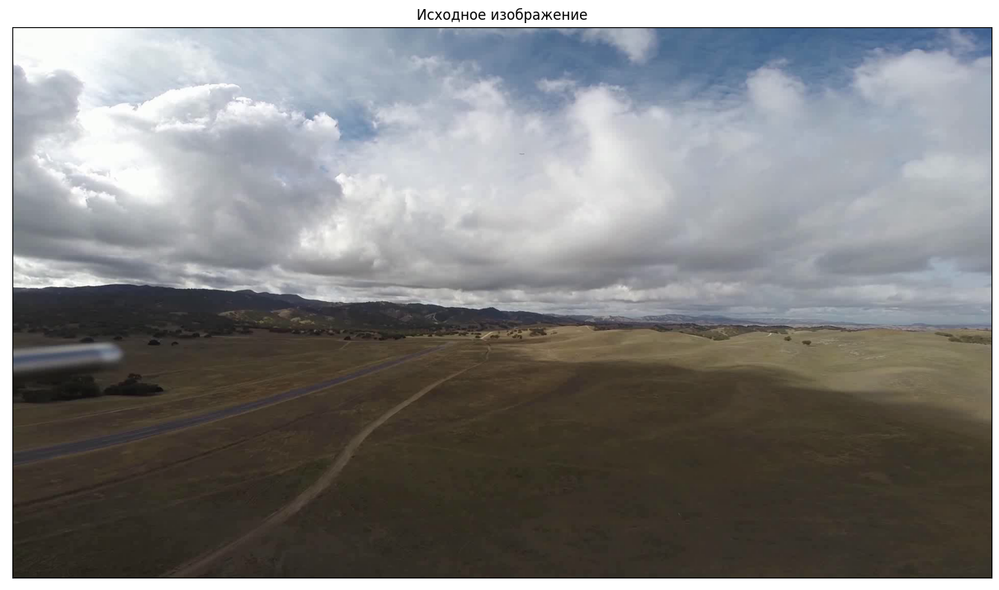

In [39]:
r_frame = cv2.cvtColor(frame.copy(), cv2.COLOR_BGR2RGB)
plot_one_image(r_frame)
h, w, _ = frame.shape

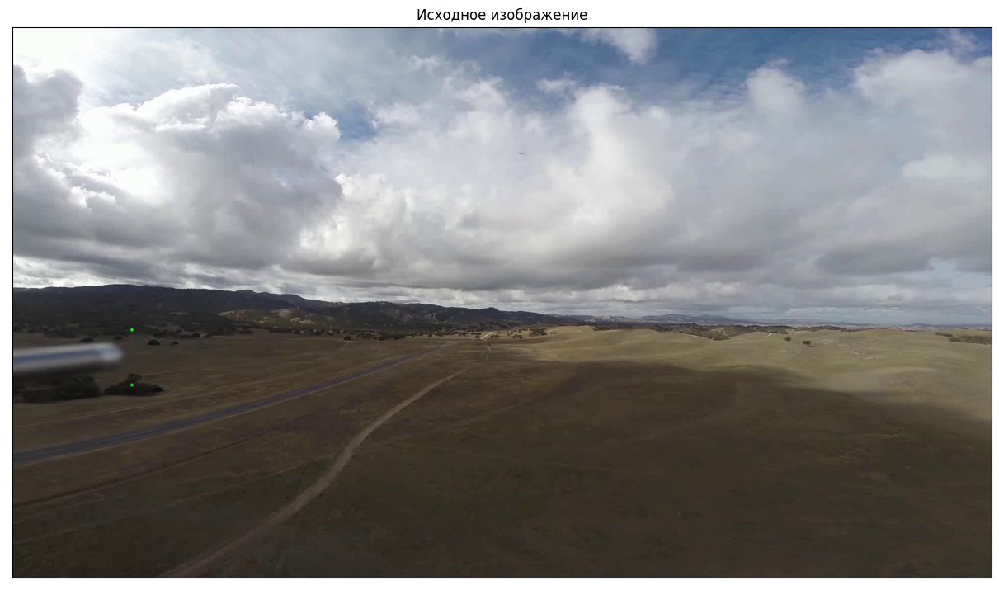

In [51]:
output = r_frame.copy()
# output = np.zeros((h,w,3))
color = (0, 255, 0)
output = cv2.circle(output, (w*11//90, h*26//40), 3, color, -1)
output = cv2.circle(output, (w*11//90, h*22//40), 3, color, -1)
plot_one_image(output)

In [168]:
cap = get_video(2)
prev = get_trajectory(cap, 100, True)
prev

Clip_03.mov
1800.0 1920.0 1080.0 29.97


  0%|          | 0/1799 [00:00<?, ?it/s]

540 756
320
aaaa [144 619]
aaaaaaaaaaaa True -137 True 1080
aaaaaaaaaaa
1347
1347


array([[[  0.,   1.]],

       [[208.,   1.]],

       [[214.,   1.]],

       ...,

       [[ 16., 832.]],

       [[118., 833.]],

       [[ 85., 839.]]], dtype=float32)

In [169]:
len(prev)

1347

In [170]:
prev = np.array([point[0] for point in prev])

In [171]:
prev

array([[  0.,   1.],
       [208.,   1.],
       [214.,   1.],
       ...,
       [ 16., 832.],
       [118., 833.],
       [ 85., 839.]], dtype=float32)

In [172]:
prevg = prev[(prev[:,1] > h*22//40) & (prev[:,1] < h*26//40)]
prevg = prevg[(prevg[:,0] < w*11//90)]

In [173]:
print(h*22//40, h*26//40)
print(w*11//90)

594 702
234


In [174]:
print(h*20//40, h*28//40)
print(w*15//90)

540 756
320


[]


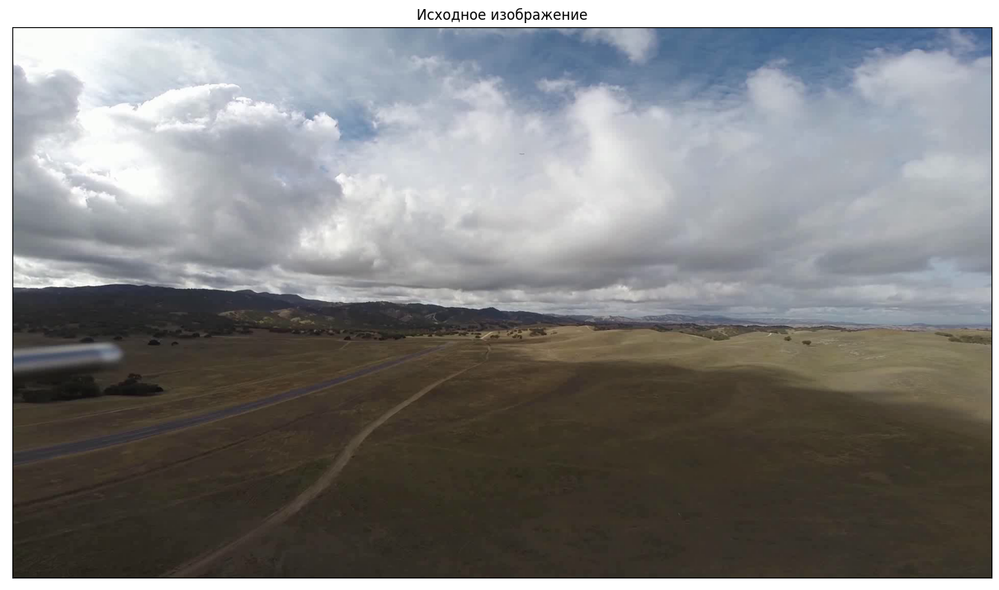

In [175]:
output = r_frame.copy()
print(prevg)
for point in prevg:
   
    pointi = np.int32(point)
    output = cv2.circle(output, (pointi[0], pointi[1]), 3, color, -1)
plot_one_image(output)

In [151]:
(619 >= h*20//40) and (619 <= h*28//40) and (144 <= w*15//90)

True

In [231]:
a = np.array([[1,2],[3,4],[5,6]])
b = np.array([[True,True],[False,False],[True,True]])
a[b]

array([1, 2, 5, 6])